# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="3"

In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

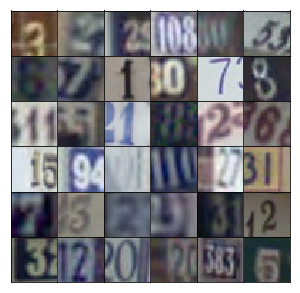

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer 4x4x512
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        # conv1 8x8x256
        x2 = tf.layers.conv2d_transpose(x, 256, 5, strides=(2,2), padding='SAME',activation=None)
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        # conv2 16x16x128
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=(2,2), padding='SAME', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(x3 * alpha, x3)
        # conv3 32 x 32 x output_dim
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='SAME', activation=None)
        # Output layer, 32x32x3
#         logits = 
        
        out = tf.tanh(logits)
        
        return out


## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 to 16x16x64
        # all the layers except the first
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='SAME')
        x = tf.maximum(x*alpha, x)
        
        # conv to 8x8x128  That is, always set training to True
        x2 = tf.layers.conv2d(x, 128, 5, strides=2, padding='SAME')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(x2*alpha, x2)
        
        # conv to 4x4x256
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='SAME')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(x3*alpha, x3)
        
#         flat = tf.layers.flatten(x3)
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 1.3122... Generator Loss: 0.7370
Epoch 1/20... Discriminator Loss: 0.5173... Generator Loss: 1.5599
Epoch 1/20... Discriminator Loss: 0.2009... Generator Loss: 2.3259
Epoch 1/20... Discriminator Loss: 0.1569... Generator Loss: 2.9044
Epoch 1/20... Discriminator Loss: 0.1494... Generator Loss: 2.8922
Epoch 1/20... Discriminator Loss: 0.1688... Generator Loss: 2.7962
Epoch 1/20... Discriminator Loss: 0.1346... Generator Loss: 2.8513
Epoch 1/20... Discriminator Loss: 0.1746... Generator Loss: 2.6634
Epoch 1/20... Discriminator Loss: 0.0918... Generator Loss: 3.5780
Epoch 1/20... Discriminator Loss: 0.0828... Generator Loss: 3.6777


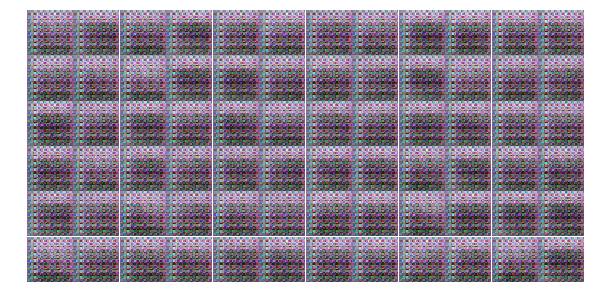

Epoch 1/20... Discriminator Loss: 0.3813... Generator Loss: 1.9830
Epoch 1/20... Discriminator Loss: 0.6995... Generator Loss: 1.3062
Epoch 1/20... Discriminator Loss: 0.5937... Generator Loss: 1.9720
Epoch 1/20... Discriminator Loss: 0.4424... Generator Loss: 1.6694
Epoch 1/20... Discriminator Loss: 0.6751... Generator Loss: 1.0900
Epoch 1/20... Discriminator Loss: 0.4006... Generator Loss: 2.3708
Epoch 1/20... Discriminator Loss: 0.3739... Generator Loss: 1.7409
Epoch 1/20... Discriminator Loss: 0.7414... Generator Loss: 1.4610
Epoch 1/20... Discriminator Loss: 0.7056... Generator Loss: 3.7638
Epoch 1/20... Discriminator Loss: 1.6859... Generator Loss: 0.9164


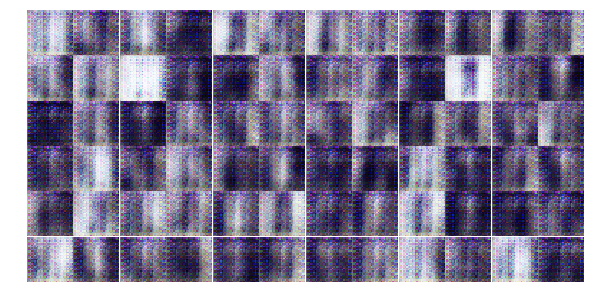

Epoch 1/20... Discriminator Loss: 0.5436... Generator Loss: 1.1713
Epoch 1/20... Discriminator Loss: 0.6041... Generator Loss: 1.0593
Epoch 1/20... Discriminator Loss: 1.2430... Generator Loss: 1.9777
Epoch 1/20... Discriminator Loss: 0.9450... Generator Loss: 0.7066
Epoch 1/20... Discriminator Loss: 0.3340... Generator Loss: 1.6820
Epoch 1/20... Discriminator Loss: 2.4162... Generator Loss: 4.9994
Epoch 1/20... Discriminator Loss: 0.6004... Generator Loss: 1.5756
Epoch 1/20... Discriminator Loss: 0.8178... Generator Loss: 0.8924
Epoch 1/20... Discriminator Loss: 1.2096... Generator Loss: 0.6119
Epoch 1/20... Discriminator Loss: 0.5551... Generator Loss: 1.3020


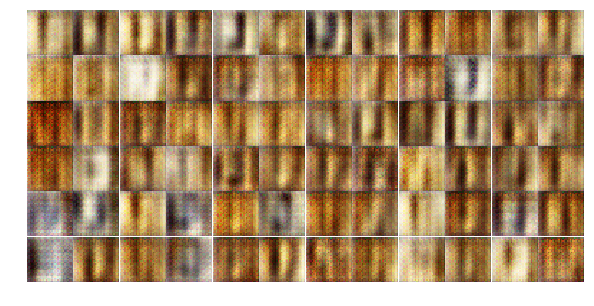

Epoch 1/20... Discriminator Loss: 0.7982... Generator Loss: 5.0194
Epoch 1/20... Discriminator Loss: 0.2455... Generator Loss: 2.1512
Epoch 1/20... Discriminator Loss: 0.6963... Generator Loss: 1.0578
Epoch 1/20... Discriminator Loss: 1.1428... Generator Loss: 0.6856
Epoch 1/20... Discriminator Loss: 0.8855... Generator Loss: 1.0018
Epoch 1/20... Discriminator Loss: 0.6839... Generator Loss: 1.4328
Epoch 1/20... Discriminator Loss: 0.9103... Generator Loss: 1.0943
Epoch 1/20... Discriminator Loss: 0.6834... Generator Loss: 1.5470
Epoch 1/20... Discriminator Loss: 0.6043... Generator Loss: 1.5519
Epoch 1/20... Discriminator Loss: 0.7376... Generator Loss: 1.0957


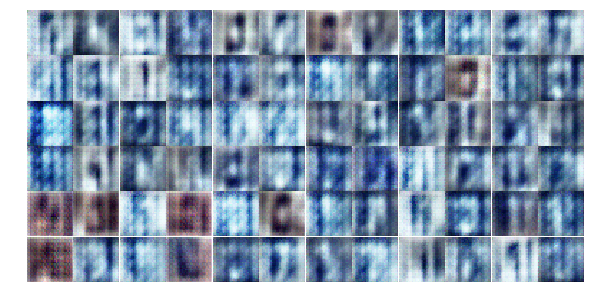

Epoch 1/20... Discriminator Loss: 0.5030... Generator Loss: 2.0704
Epoch 1/20... Discriminator Loss: 0.8214... Generator Loss: 0.8998
Epoch 1/20... Discriminator Loss: 1.1224... Generator Loss: 0.9691
Epoch 1/20... Discriminator Loss: 2.0102... Generator Loss: 0.2653
Epoch 1/20... Discriminator Loss: 1.0353... Generator Loss: 0.9423
Epoch 1/20... Discriminator Loss: 0.6817... Generator Loss: 1.3837
Epoch 1/20... Discriminator Loss: 0.9205... Generator Loss: 1.0331
Epoch 1/20... Discriminator Loss: 0.7882... Generator Loss: 1.4364
Epoch 1/20... Discriminator Loss: 0.8544... Generator Loss: 1.0768
Epoch 1/20... Discriminator Loss: 0.8758... Generator Loss: 1.6673


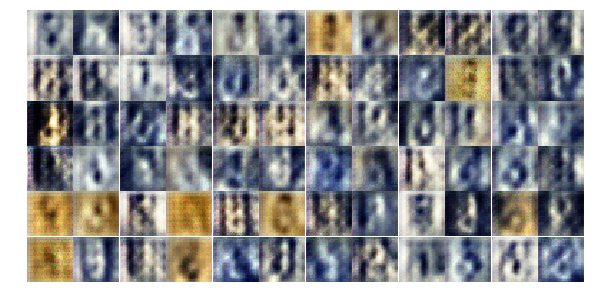

Epoch 1/20... Discriminator Loss: 0.6912... Generator Loss: 1.4717
Epoch 1/20... Discriminator Loss: 0.7168... Generator Loss: 1.0705
Epoch 1/20... Discriminator Loss: 0.7906... Generator Loss: 1.6002
Epoch 1/20... Discriminator Loss: 1.0781... Generator Loss: 0.8497
Epoch 1/20... Discriminator Loss: 0.5622... Generator Loss: 2.0486
Epoch 1/20... Discriminator Loss: 0.6998... Generator Loss: 1.8210
Epoch 1/20... Discriminator Loss: 1.0491... Generator Loss: 1.8632
Epoch 2/20... Discriminator Loss: 1.0502... Generator Loss: 1.6099
Epoch 2/20... Discriminator Loss: 0.7297... Generator Loss: 1.4530
Epoch 2/20... Discriminator Loss: 0.9855... Generator Loss: 1.0567


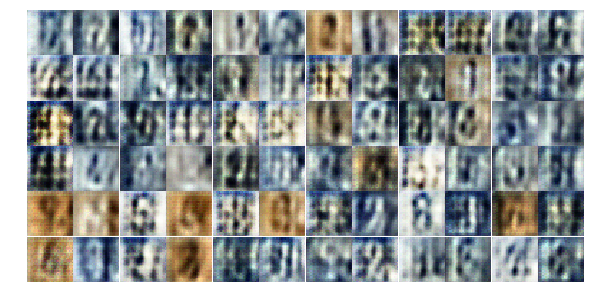

Epoch 2/20... Discriminator Loss: 0.8326... Generator Loss: 1.2656
Epoch 2/20... Discriminator Loss: 0.8688... Generator Loss: 1.0061
Epoch 2/20... Discriminator Loss: 0.9583... Generator Loss: 1.1547
Epoch 2/20... Discriminator Loss: 1.3098... Generator Loss: 0.5813
Epoch 2/20... Discriminator Loss: 1.1673... Generator Loss: 1.0026
Epoch 2/20... Discriminator Loss: 0.8026... Generator Loss: 1.3792
Epoch 2/20... Discriminator Loss: 1.0827... Generator Loss: 1.0879
Epoch 2/20... Discriminator Loss: 0.7408... Generator Loss: 1.7598
Epoch 2/20... Discriminator Loss: 1.0865... Generator Loss: 1.0372
Epoch 2/20... Discriminator Loss: 1.0251... Generator Loss: 1.0311


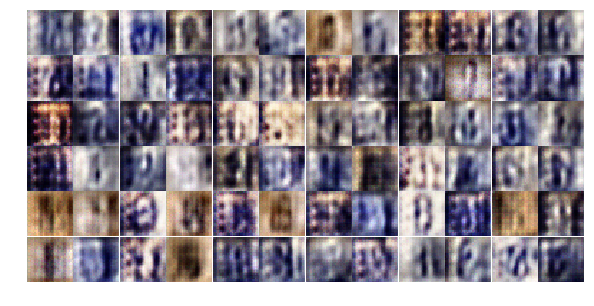

Epoch 2/20... Discriminator Loss: 1.1205... Generator Loss: 0.7627
Epoch 2/20... Discriminator Loss: 0.6463... Generator Loss: 1.5418
Epoch 2/20... Discriminator Loss: 0.6933... Generator Loss: 1.6102
Epoch 2/20... Discriminator Loss: 0.6272... Generator Loss: 1.4218
Epoch 2/20... Discriminator Loss: 1.2410... Generator Loss: 0.9734
Epoch 2/20... Discriminator Loss: 1.1529... Generator Loss: 0.8471
Epoch 2/20... Discriminator Loss: 1.0634... Generator Loss: 0.7724
Epoch 2/20... Discriminator Loss: 1.0851... Generator Loss: 0.6834
Epoch 2/20... Discriminator Loss: 0.8845... Generator Loss: 1.1883
Epoch 2/20... Discriminator Loss: 1.1553... Generator Loss: 0.6457


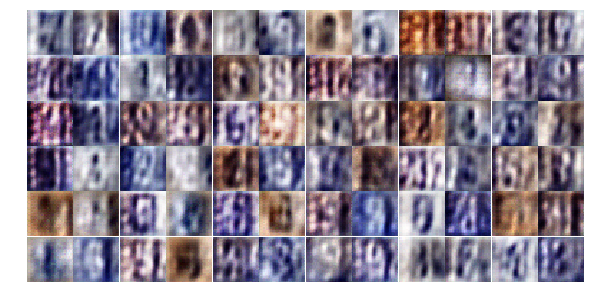

Epoch 2/20... Discriminator Loss: 0.9836... Generator Loss: 1.0389
Epoch 2/20... Discriminator Loss: 0.9478... Generator Loss: 1.1520
Epoch 2/20... Discriminator Loss: 0.7653... Generator Loss: 1.2793
Epoch 2/20... Discriminator Loss: 1.0618... Generator Loss: 1.6829
Epoch 2/20... Discriminator Loss: 1.0991... Generator Loss: 0.8854
Epoch 2/20... Discriminator Loss: 1.3097... Generator Loss: 1.3468
Epoch 2/20... Discriminator Loss: 1.2128... Generator Loss: 0.5880
Epoch 2/20... Discriminator Loss: 1.0089... Generator Loss: 0.8505
Epoch 2/20... Discriminator Loss: 1.0938... Generator Loss: 0.7347
Epoch 2/20... Discriminator Loss: 0.9396... Generator Loss: 1.0568


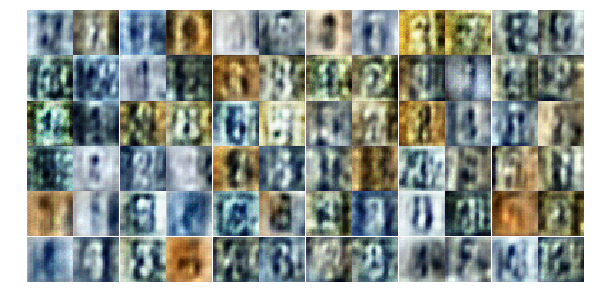

Epoch 2/20... Discriminator Loss: 0.8462... Generator Loss: 1.6384
Epoch 2/20... Discriminator Loss: 0.8258... Generator Loss: 1.3559
Epoch 2/20... Discriminator Loss: 1.3218... Generator Loss: 0.6330
Epoch 2/20... Discriminator Loss: 1.2906... Generator Loss: 0.4646
Epoch 2/20... Discriminator Loss: 0.9830... Generator Loss: 1.5942
Epoch 2/20... Discriminator Loss: 1.4114... Generator Loss: 0.7104
Epoch 2/20... Discriminator Loss: 1.3021... Generator Loss: 0.5967
Epoch 2/20... Discriminator Loss: 0.8007... Generator Loss: 1.4549
Epoch 2/20... Discriminator Loss: 0.9560... Generator Loss: 1.3931
Epoch 2/20... Discriminator Loss: 0.7106... Generator Loss: 1.5007


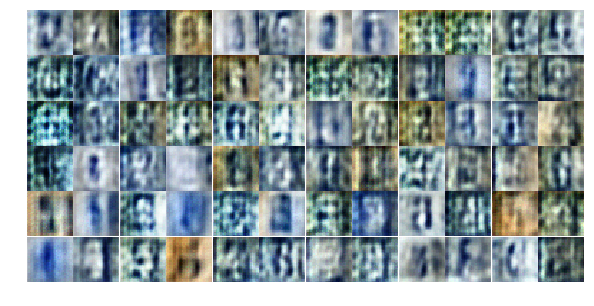

Epoch 2/20... Discriminator Loss: 0.7053... Generator Loss: 1.3445
Epoch 2/20... Discriminator Loss: 1.3045... Generator Loss: 0.8313
Epoch 2/20... Discriminator Loss: 1.0763... Generator Loss: 1.1649
Epoch 2/20... Discriminator Loss: 0.9490... Generator Loss: 0.8873
Epoch 2/20... Discriminator Loss: 0.7700... Generator Loss: 1.1691
Epoch 2/20... Discriminator Loss: 1.6313... Generator Loss: 0.3701
Epoch 2/20... Discriminator Loss: 1.2347... Generator Loss: 2.1254
Epoch 2/20... Discriminator Loss: 0.9062... Generator Loss: 0.8967
Epoch 2/20... Discriminator Loss: 0.8427... Generator Loss: 1.1029
Epoch 2/20... Discriminator Loss: 0.8631... Generator Loss: 1.1185


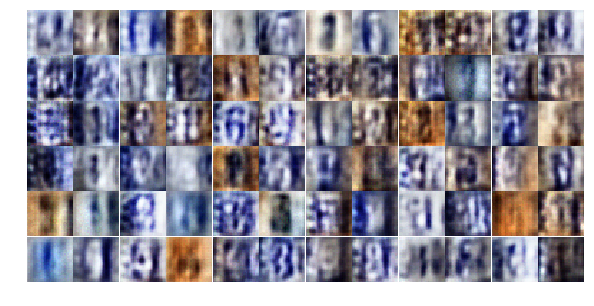

Epoch 2/20... Discriminator Loss: 1.0437... Generator Loss: 0.9302
Epoch 2/20... Discriminator Loss: 1.2915... Generator Loss: 0.6334
Epoch 2/20... Discriminator Loss: 1.1837... Generator Loss: 1.2471
Epoch 2/20... Discriminator Loss: 1.1050... Generator Loss: 0.8213
Epoch 3/20... Discriminator Loss: 0.6920... Generator Loss: 1.7573
Epoch 3/20... Discriminator Loss: 0.8256... Generator Loss: 1.1245
Epoch 3/20... Discriminator Loss: 0.8494... Generator Loss: 1.9309
Epoch 3/20... Discriminator Loss: 0.6825... Generator Loss: 1.1678
Epoch 3/20... Discriminator Loss: 0.5258... Generator Loss: 1.6341
Epoch 3/20... Discriminator Loss: 0.7652... Generator Loss: 1.0812


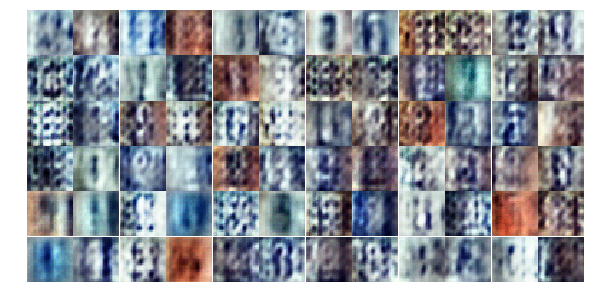

Epoch 3/20... Discriminator Loss: 0.5945... Generator Loss: 1.5776
Epoch 3/20... Discriminator Loss: 0.7987... Generator Loss: 1.4560
Epoch 3/20... Discriminator Loss: 0.8767... Generator Loss: 0.8727
Epoch 3/20... Discriminator Loss: 0.6424... Generator Loss: 1.3163
Epoch 3/20... Discriminator Loss: 0.6472... Generator Loss: 1.0593
Epoch 3/20... Discriminator Loss: 1.7440... Generator Loss: 0.3811
Epoch 3/20... Discriminator Loss: 1.4774... Generator Loss: 0.5409
Epoch 3/20... Discriminator Loss: 0.7116... Generator Loss: 1.5152
Epoch 3/20... Discriminator Loss: 0.9164... Generator Loss: 0.7792
Epoch 3/20... Discriminator Loss: 1.0939... Generator Loss: 0.9133


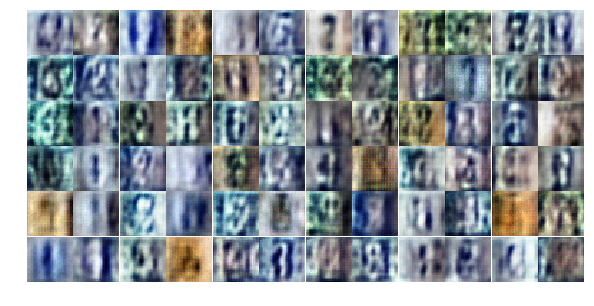

Epoch 3/20... Discriminator Loss: 0.6640... Generator Loss: 1.4838
Epoch 3/20... Discriminator Loss: 0.9963... Generator Loss: 0.8398
Epoch 3/20... Discriminator Loss: 0.8803... Generator Loss: 1.1040
Epoch 3/20... Discriminator Loss: 0.7209... Generator Loss: 1.1669
Epoch 3/20... Discriminator Loss: 0.9829... Generator Loss: 0.6723
Epoch 3/20... Discriminator Loss: 0.4494... Generator Loss: 2.1394
Epoch 3/20... Discriminator Loss: 0.6497... Generator Loss: 1.6067
Epoch 3/20... Discriminator Loss: 0.7586... Generator Loss: 1.0172
Epoch 3/20... Discriminator Loss: 0.6279... Generator Loss: 1.8477
Epoch 3/20... Discriminator Loss: 1.0070... Generator Loss: 0.7613


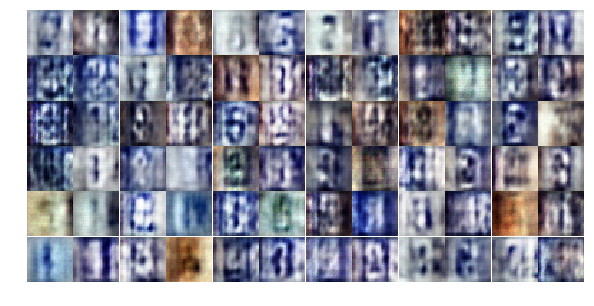

Epoch 3/20... Discriminator Loss: 0.8727... Generator Loss: 1.2704
Epoch 3/20... Discriminator Loss: 0.8244... Generator Loss: 1.1215
Epoch 3/20... Discriminator Loss: 1.1872... Generator Loss: 0.6740
Epoch 3/20... Discriminator Loss: 0.7999... Generator Loss: 0.7925
Epoch 3/20... Discriminator Loss: 1.0112... Generator Loss: 0.7763
Epoch 3/20... Discriminator Loss: 0.6379... Generator Loss: 1.4234
Epoch 3/20... Discriminator Loss: 0.7606... Generator Loss: 1.2075
Epoch 3/20... Discriminator Loss: 0.7586... Generator Loss: 1.0247
Epoch 3/20... Discriminator Loss: 0.6743... Generator Loss: 1.1010
Epoch 3/20... Discriminator Loss: 0.6432... Generator Loss: 1.6114


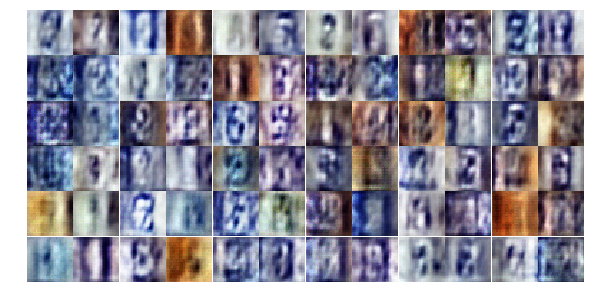

Epoch 3/20... Discriminator Loss: 0.6042... Generator Loss: 1.7300
Epoch 3/20... Discriminator Loss: 0.3443... Generator Loss: 2.5333
Epoch 3/20... Discriminator Loss: 0.7358... Generator Loss: 1.1746
Epoch 3/20... Discriminator Loss: 0.5713... Generator Loss: 1.5706
Epoch 3/20... Discriminator Loss: 1.1010... Generator Loss: 2.3066
Epoch 3/20... Discriminator Loss: 0.6853... Generator Loss: 1.5540
Epoch 3/20... Discriminator Loss: 1.0194... Generator Loss: 1.7472
Epoch 3/20... Discriminator Loss: 0.7135... Generator Loss: 1.1274
Epoch 3/20... Discriminator Loss: 1.0142... Generator Loss: 0.7926
Epoch 3/20... Discriminator Loss: 0.9487... Generator Loss: 2.0059


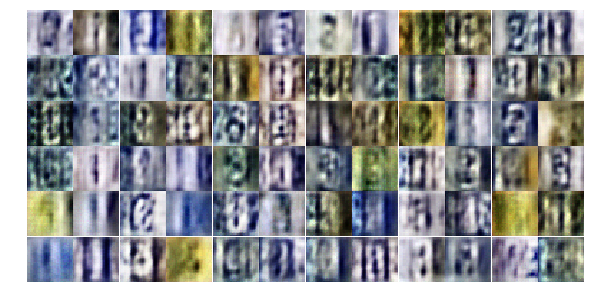

Epoch 3/20... Discriminator Loss: 1.1386... Generator Loss: 0.8505
Epoch 3/20... Discriminator Loss: 0.7772... Generator Loss: 1.3477
Epoch 3/20... Discriminator Loss: 0.6906... Generator Loss: 1.2196
Epoch 3/20... Discriminator Loss: 0.6965... Generator Loss: 1.3522
Epoch 3/20... Discriminator Loss: 1.4062... Generator Loss: 1.5965
Epoch 3/20... Discriminator Loss: 0.5053... Generator Loss: 1.5624
Epoch 3/20... Discriminator Loss: 0.7178... Generator Loss: 2.3546
Epoch 3/20... Discriminator Loss: 0.5271... Generator Loss: 1.8129
Epoch 3/20... Discriminator Loss: 0.6321... Generator Loss: 1.1365
Epoch 3/20... Discriminator Loss: 0.4256... Generator Loss: 1.8601


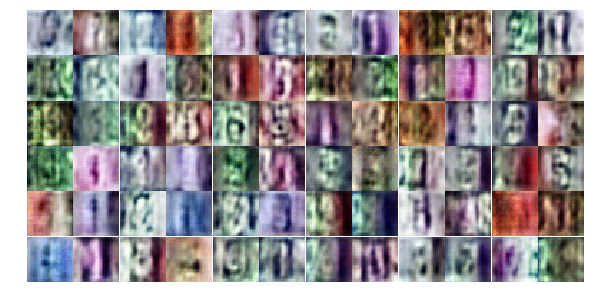

Epoch 3/20... Discriminator Loss: 1.4445... Generator Loss: 0.4119
Epoch 4/20... Discriminator Loss: 0.9267... Generator Loss: 0.7966
Epoch 4/20... Discriminator Loss: 0.9645... Generator Loss: 1.1599
Epoch 4/20... Discriminator Loss: 0.7254... Generator Loss: 1.5718
Epoch 4/20... Discriminator Loss: 0.7224... Generator Loss: 1.6296
Epoch 4/20... Discriminator Loss: 0.5927... Generator Loss: 1.2646
Epoch 4/20... Discriminator Loss: 0.9070... Generator Loss: 0.8554
Epoch 4/20... Discriminator Loss: 0.7315... Generator Loss: 1.1409
Epoch 4/20... Discriminator Loss: 0.4820... Generator Loss: 2.2998
Epoch 4/20... Discriminator Loss: 0.6265... Generator Loss: 1.3110


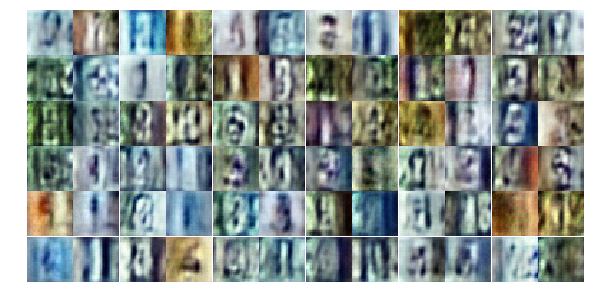

Epoch 4/20... Discriminator Loss: 0.6172... Generator Loss: 1.2948
Epoch 4/20... Discriminator Loss: 0.9497... Generator Loss: 1.6908
Epoch 4/20... Discriminator Loss: 0.8617... Generator Loss: 1.4846
Epoch 4/20... Discriminator Loss: 0.7088... Generator Loss: 1.3706
Epoch 4/20... Discriminator Loss: 1.0547... Generator Loss: 1.9488
Epoch 4/20... Discriminator Loss: 1.2588... Generator Loss: 0.4682
Epoch 4/20... Discriminator Loss: 0.8580... Generator Loss: 0.7806
Epoch 4/20... Discriminator Loss: 0.7087... Generator Loss: 1.2788
Epoch 4/20... Discriminator Loss: 0.7141... Generator Loss: 1.5103
Epoch 4/20... Discriminator Loss: 0.6656... Generator Loss: 1.5636


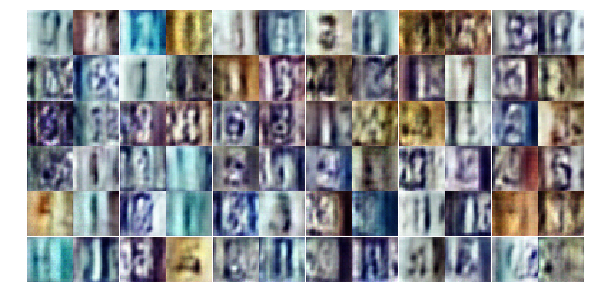

Epoch 4/20... Discriminator Loss: 0.6401... Generator Loss: 1.4393
Epoch 4/20... Discriminator Loss: 0.4833... Generator Loss: 2.1616
Epoch 4/20... Discriminator Loss: 1.4564... Generator Loss: 0.3579
Epoch 4/20... Discriminator Loss: 0.9728... Generator Loss: 1.2453
Epoch 4/20... Discriminator Loss: 0.5313... Generator Loss: 1.4070
Epoch 4/20... Discriminator Loss: 0.5180... Generator Loss: 1.5627
Epoch 4/20... Discriminator Loss: 0.4546... Generator Loss: 1.5149
Epoch 4/20... Discriminator Loss: 0.7371... Generator Loss: 0.9013
Epoch 4/20... Discriminator Loss: 0.4080... Generator Loss: 2.1946
Epoch 4/20... Discriminator Loss: 0.6062... Generator Loss: 1.4707


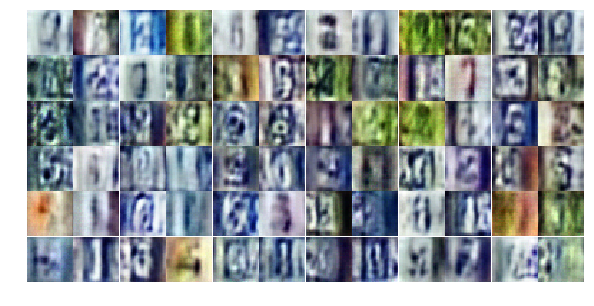

Epoch 4/20... Discriminator Loss: 0.5312... Generator Loss: 2.1124
Epoch 4/20... Discriminator Loss: 0.8312... Generator Loss: 1.9493
Epoch 4/20... Discriminator Loss: 0.6166... Generator Loss: 1.2308
Epoch 4/20... Discriminator Loss: 0.6401... Generator Loss: 1.1875
Epoch 4/20... Discriminator Loss: 0.4172... Generator Loss: 1.8968
Epoch 4/20... Discriminator Loss: 0.4910... Generator Loss: 1.9369
Epoch 4/20... Discriminator Loss: 0.5278... Generator Loss: 1.5366
Epoch 4/20... Discriminator Loss: 1.8114... Generator Loss: 0.2442
Epoch 4/20... Discriminator Loss: 0.7894... Generator Loss: 1.7871
Epoch 4/20... Discriminator Loss: 0.6734... Generator Loss: 2.2405


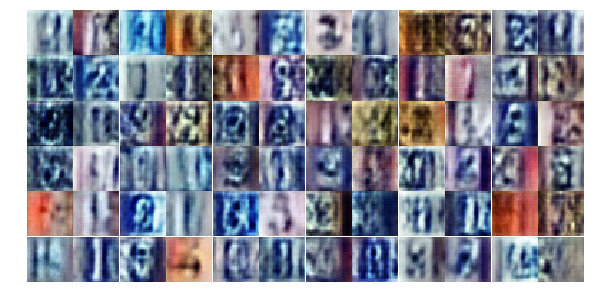

Epoch 4/20... Discriminator Loss: 0.7987... Generator Loss: 0.8799
Epoch 4/20... Discriminator Loss: 0.4189... Generator Loss: 2.0027
Epoch 4/20... Discriminator Loss: 0.5311... Generator Loss: 1.7290
Epoch 4/20... Discriminator Loss: 0.4930... Generator Loss: 1.7469
Epoch 4/20... Discriminator Loss: 0.3150... Generator Loss: 2.1579
Epoch 4/20... Discriminator Loss: 1.0588... Generator Loss: 2.6266
Epoch 4/20... Discriminator Loss: 1.0671... Generator Loss: 1.4473
Epoch 4/20... Discriminator Loss: 0.6411... Generator Loss: 1.2786
Epoch 4/20... Discriminator Loss: 0.6386... Generator Loss: 1.1986
Epoch 4/20... Discriminator Loss: 0.4512... Generator Loss: 1.8500


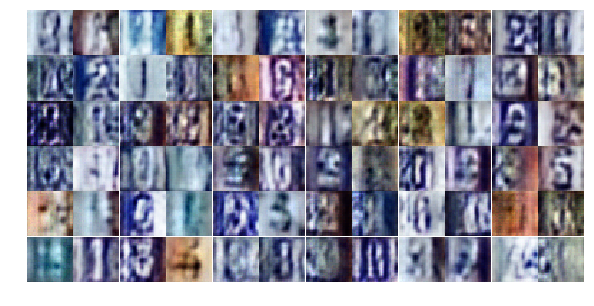

Epoch 4/20... Discriminator Loss: 0.6552... Generator Loss: 1.4511
Epoch 4/20... Discriminator Loss: 0.7415... Generator Loss: 1.1112
Epoch 4/20... Discriminator Loss: 0.3176... Generator Loss: 2.5284
Epoch 4/20... Discriminator Loss: 0.6781... Generator Loss: 2.1867
Epoch 4/20... Discriminator Loss: 0.6176... Generator Loss: 1.5737
Epoch 4/20... Discriminator Loss: 0.6708... Generator Loss: 1.1389
Epoch 4/20... Discriminator Loss: 0.6417... Generator Loss: 1.0384
Epoch 4/20... Discriminator Loss: 0.6079... Generator Loss: 1.3096
Epoch 4/20... Discriminator Loss: 0.6139... Generator Loss: 1.0481
Epoch 5/20... Discriminator Loss: 0.5367... Generator Loss: 1.6300


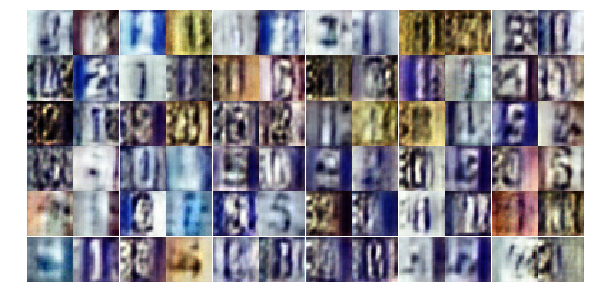

Epoch 5/20... Discriminator Loss: 1.0443... Generator Loss: 0.5764
Epoch 5/20... Discriminator Loss: 1.0193... Generator Loss: 0.7722
Epoch 5/20... Discriminator Loss: 0.4405... Generator Loss: 1.7323
Epoch 5/20... Discriminator Loss: 0.5505... Generator Loss: 1.5365
Epoch 5/20... Discriminator Loss: 0.5869... Generator Loss: 1.2212
Epoch 5/20... Discriminator Loss: 0.7930... Generator Loss: 0.8877
Epoch 5/20... Discriminator Loss: 0.6697... Generator Loss: 0.9982
Epoch 5/20... Discriminator Loss: 0.8780... Generator Loss: 0.7176
Epoch 5/20... Discriminator Loss: 0.5053... Generator Loss: 1.4373
Epoch 5/20... Discriminator Loss: 0.6603... Generator Loss: 1.0745


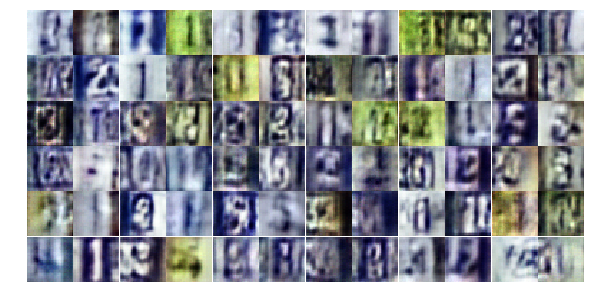

Epoch 5/20... Discriminator Loss: 0.6464... Generator Loss: 2.2952
Epoch 5/20... Discriminator Loss: 0.8079... Generator Loss: 0.7837
Epoch 5/20... Discriminator Loss: 0.7644... Generator Loss: 2.2210
Epoch 5/20... Discriminator Loss: 1.0656... Generator Loss: 1.9091
Epoch 5/20... Discriminator Loss: 0.7362... Generator Loss: 1.0578
Epoch 5/20... Discriminator Loss: 0.7849... Generator Loss: 0.9333
Epoch 5/20... Discriminator Loss: 0.5169... Generator Loss: 1.7624
Epoch 5/20... Discriminator Loss: 0.5199... Generator Loss: 1.3168
Epoch 5/20... Discriminator Loss: 0.5484... Generator Loss: 1.5743
Epoch 5/20... Discriminator Loss: 0.6005... Generator Loss: 1.1985


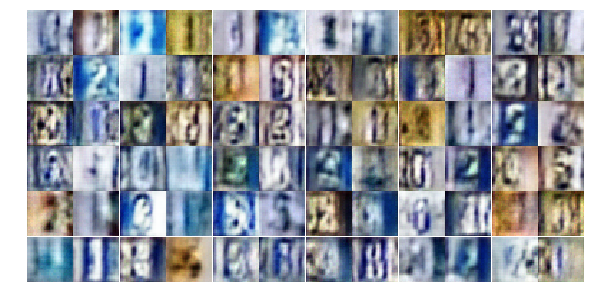

Epoch 5/20... Discriminator Loss: 0.6541... Generator Loss: 1.1649
Epoch 5/20... Discriminator Loss: 0.7407... Generator Loss: 1.1262
Epoch 5/20... Discriminator Loss: 0.5936... Generator Loss: 1.1813
Epoch 5/20... Discriminator Loss: 0.8815... Generator Loss: 0.7478
Epoch 5/20... Discriminator Loss: 0.9714... Generator Loss: 0.6335
Epoch 5/20... Discriminator Loss: 0.6085... Generator Loss: 1.2631
Epoch 5/20... Discriminator Loss: 0.6020... Generator Loss: 1.1275
Epoch 5/20... Discriminator Loss: 1.2199... Generator Loss: 0.4965
Epoch 5/20... Discriminator Loss: 0.8097... Generator Loss: 1.3693
Epoch 5/20... Discriminator Loss: 0.9614... Generator Loss: 0.7115


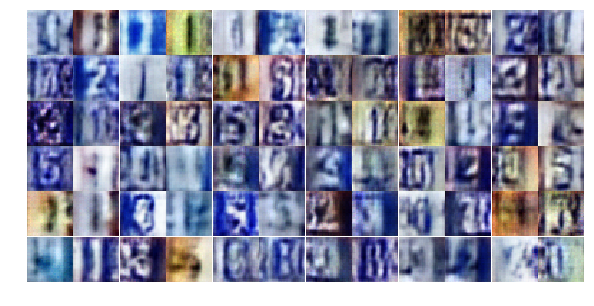

Epoch 5/20... Discriminator Loss: 0.8236... Generator Loss: 1.3718
Epoch 5/20... Discriminator Loss: 0.7018... Generator Loss: 0.9958
Epoch 5/20... Discriminator Loss: 0.6472... Generator Loss: 1.6859
Epoch 5/20... Discriminator Loss: 0.4499... Generator Loss: 1.4445
Epoch 5/20... Discriminator Loss: 0.5852... Generator Loss: 2.0355
Epoch 5/20... Discriminator Loss: 0.5676... Generator Loss: 2.1604
Epoch 5/20... Discriminator Loss: 0.8914... Generator Loss: 0.7032
Epoch 5/20... Discriminator Loss: 0.8660... Generator Loss: 0.8277
Epoch 5/20... Discriminator Loss: 0.9687... Generator Loss: 0.8052
Epoch 5/20... Discriminator Loss: 0.7043... Generator Loss: 0.9631


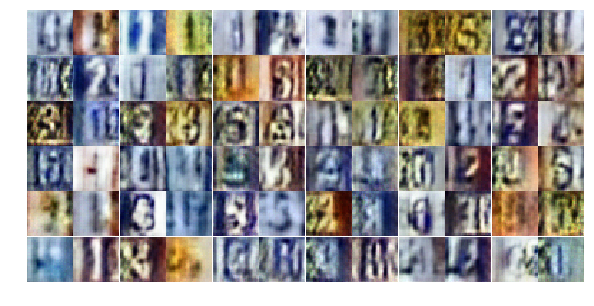

Epoch 5/20... Discriminator Loss: 0.8237... Generator Loss: 0.8780
Epoch 5/20... Discriminator Loss: 1.2466... Generator Loss: 0.4912
Epoch 5/20... Discriminator Loss: 1.2729... Generator Loss: 0.4968
Epoch 5/20... Discriminator Loss: 0.5298... Generator Loss: 2.1716
Epoch 5/20... Discriminator Loss: 0.9916... Generator Loss: 1.6061
Epoch 5/20... Discriminator Loss: 0.8629... Generator Loss: 0.7376
Epoch 5/20... Discriminator Loss: 0.8275... Generator Loss: 1.9407
Epoch 5/20... Discriminator Loss: 0.5905... Generator Loss: 1.5777
Epoch 5/20... Discriminator Loss: 0.5961... Generator Loss: 1.1886
Epoch 5/20... Discriminator Loss: 0.6454... Generator Loss: 2.4340


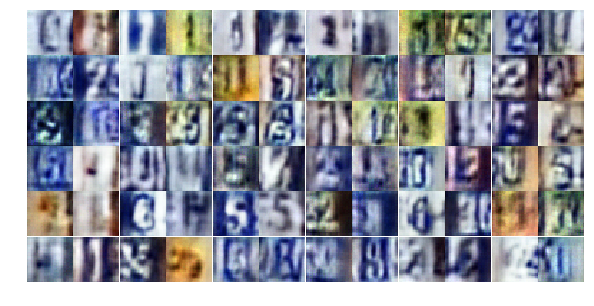

Epoch 5/20... Discriminator Loss: 0.6119... Generator Loss: 1.7852
Epoch 5/20... Discriminator Loss: 0.8548... Generator Loss: 0.8296
Epoch 5/20... Discriminator Loss: 0.5310... Generator Loss: 1.4077
Epoch 5/20... Discriminator Loss: 0.8450... Generator Loss: 0.7078
Epoch 5/20... Discriminator Loss: 0.7425... Generator Loss: 3.0345
Epoch 5/20... Discriminator Loss: 1.2547... Generator Loss: 0.5039
Epoch 6/20... Discriminator Loss: 0.7051... Generator Loss: 1.1130
Epoch 6/20... Discriminator Loss: 0.4997... Generator Loss: 1.4063
Epoch 6/20... Discriminator Loss: 0.6765... Generator Loss: 1.3042
Epoch 6/20... Discriminator Loss: 0.8209... Generator Loss: 0.8623


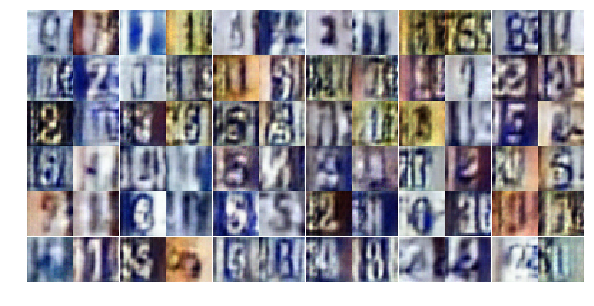

Epoch 6/20... Discriminator Loss: 0.6029... Generator Loss: 1.1311
Epoch 6/20... Discriminator Loss: 0.5325... Generator Loss: 1.7410
Epoch 6/20... Discriminator Loss: 0.9500... Generator Loss: 0.6807
Epoch 6/20... Discriminator Loss: 0.8678... Generator Loss: 0.9049
Epoch 6/20... Discriminator Loss: 0.8007... Generator Loss: 0.9366
Epoch 6/20... Discriminator Loss: 0.6951... Generator Loss: 0.9538
Epoch 6/20... Discriminator Loss: 0.5134... Generator Loss: 1.5540
Epoch 6/20... Discriminator Loss: 0.7422... Generator Loss: 1.2736
Epoch 6/20... Discriminator Loss: 0.6429... Generator Loss: 1.1520
Epoch 6/20... Discriminator Loss: 0.6269... Generator Loss: 1.4345


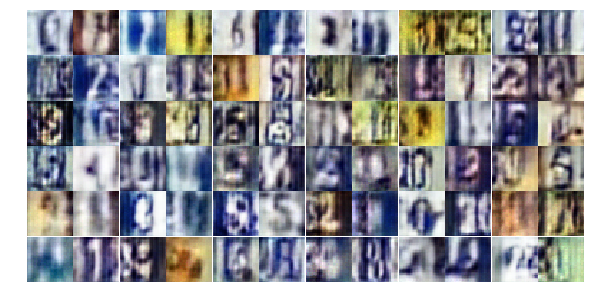

Epoch 6/20... Discriminator Loss: 0.6883... Generator Loss: 0.9582
Epoch 6/20... Discriminator Loss: 1.3401... Generator Loss: 1.2553
Epoch 6/20... Discriminator Loss: 1.3019... Generator Loss: 0.4562
Epoch 6/20... Discriminator Loss: 0.5799... Generator Loss: 1.1632
Epoch 6/20... Discriminator Loss: 0.5659... Generator Loss: 1.2604
Epoch 6/20... Discriminator Loss: 0.4915... Generator Loss: 1.6509
Epoch 6/20... Discriminator Loss: 0.5869... Generator Loss: 1.3258
Epoch 6/20... Discriminator Loss: 0.8068... Generator Loss: 0.8118
Epoch 6/20... Discriminator Loss: 0.5970... Generator Loss: 1.9837
Epoch 6/20... Discriminator Loss: 1.0135... Generator Loss: 0.5810


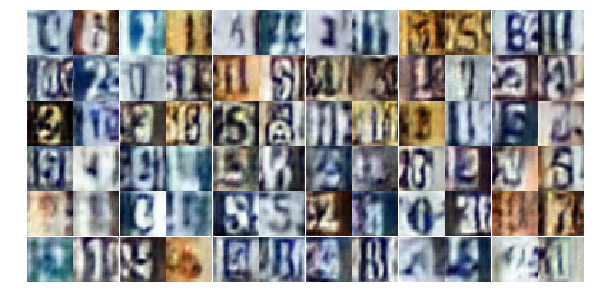

Epoch 6/20... Discriminator Loss: 0.7608... Generator Loss: 0.8460
Epoch 6/20... Discriminator Loss: 0.8892... Generator Loss: 1.7804
Epoch 6/20... Discriminator Loss: 0.8946... Generator Loss: 0.8472
Epoch 6/20... Discriminator Loss: 0.6429... Generator Loss: 2.0048
Epoch 6/20... Discriminator Loss: 2.0047... Generator Loss: 3.8420
Epoch 6/20... Discriminator Loss: 1.1322... Generator Loss: 0.9626
Epoch 6/20... Discriminator Loss: 0.7402... Generator Loss: 1.0616
Epoch 6/20... Discriminator Loss: 0.4882... Generator Loss: 1.4934
Epoch 6/20... Discriminator Loss: 0.6386... Generator Loss: 1.3049
Epoch 6/20... Discriminator Loss: 0.5345... Generator Loss: 1.6450


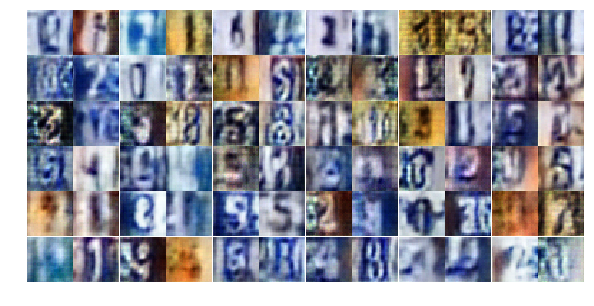

Epoch 6/20... Discriminator Loss: 1.0490... Generator Loss: 0.6109
Epoch 6/20... Discriminator Loss: 0.6238... Generator Loss: 2.1452
Epoch 6/20... Discriminator Loss: 0.6996... Generator Loss: 1.0829
Epoch 6/20... Discriminator Loss: 0.8948... Generator Loss: 0.7682
Epoch 6/20... Discriminator Loss: 0.7790... Generator Loss: 1.2856
Epoch 6/20... Discriminator Loss: 1.0349... Generator Loss: 0.6128
Epoch 6/20... Discriminator Loss: 0.6864... Generator Loss: 1.0677
Epoch 6/20... Discriminator Loss: 0.4954... Generator Loss: 1.5984
Epoch 6/20... Discriminator Loss: 0.8770... Generator Loss: 0.8157
Epoch 6/20... Discriminator Loss: 0.7622... Generator Loss: 0.8510


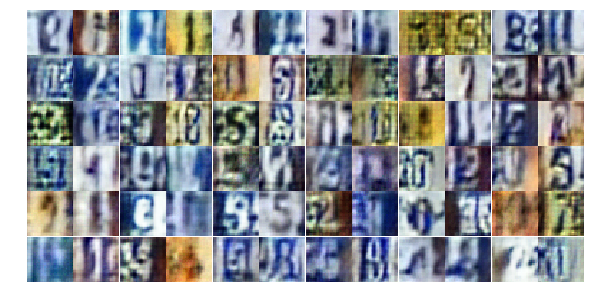

Epoch 6/20... Discriminator Loss: 0.7565... Generator Loss: 0.9467
Epoch 6/20... Discriminator Loss: 0.9001... Generator Loss: 1.5577
Epoch 6/20... Discriminator Loss: 0.9765... Generator Loss: 0.6698
Epoch 6/20... Discriminator Loss: 0.5303... Generator Loss: 1.4289
Epoch 6/20... Discriminator Loss: 0.4328... Generator Loss: 1.5019
Epoch 6/20... Discriminator Loss: 0.7718... Generator Loss: 0.8193
Epoch 6/20... Discriminator Loss: 0.7574... Generator Loss: 0.9296
Epoch 6/20... Discriminator Loss: 0.6290... Generator Loss: 1.0200
Epoch 6/20... Discriminator Loss: 0.6802... Generator Loss: 1.0196
Epoch 6/20... Discriminator Loss: 1.1777... Generator Loss: 0.9408


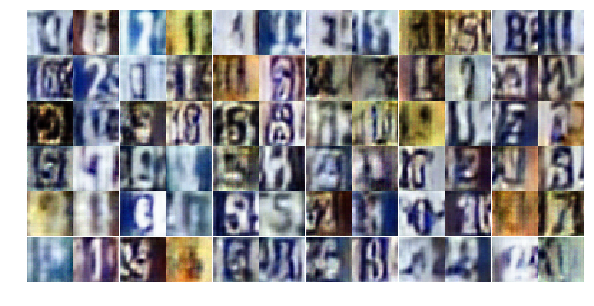

Epoch 6/20... Discriminator Loss: 0.7431... Generator Loss: 1.3168
Epoch 6/20... Discriminator Loss: 0.6159... Generator Loss: 1.4472
Epoch 6/20... Discriminator Loss: 0.6539... Generator Loss: 1.4186
Epoch 7/20... Discriminator Loss: 0.6925... Generator Loss: 1.4266
Epoch 7/20... Discriminator Loss: 0.7608... Generator Loss: 0.9685
Epoch 7/20... Discriminator Loss: 0.6660... Generator Loss: 1.8563
Epoch 7/20... Discriminator Loss: 1.5311... Generator Loss: 0.3353
Epoch 7/20... Discriminator Loss: 0.7110... Generator Loss: 1.1049
Epoch 7/20... Discriminator Loss: 0.6668... Generator Loss: 1.0628
Epoch 7/20... Discriminator Loss: 0.5598... Generator Loss: 1.8054


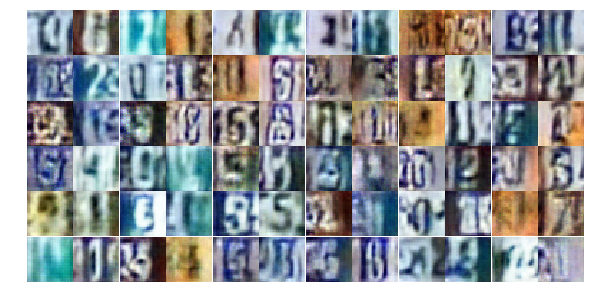

Epoch 7/20... Discriminator Loss: 0.5959... Generator Loss: 1.2687
Epoch 7/20... Discriminator Loss: 0.6011... Generator Loss: 1.3889
Epoch 7/20... Discriminator Loss: 0.6228... Generator Loss: 1.4590
Epoch 7/20... Discriminator Loss: 0.8947... Generator Loss: 3.0141
Epoch 7/20... Discriminator Loss: 0.5416... Generator Loss: 1.4677
Epoch 7/20... Discriminator Loss: 0.4734... Generator Loss: 1.4265
Epoch 7/20... Discriminator Loss: 0.8560... Generator Loss: 2.0824
Epoch 7/20... Discriminator Loss: 0.6894... Generator Loss: 2.4927
Epoch 7/20... Discriminator Loss: 0.6785... Generator Loss: 2.0333
Epoch 7/20... Discriminator Loss: 0.6898... Generator Loss: 0.9655


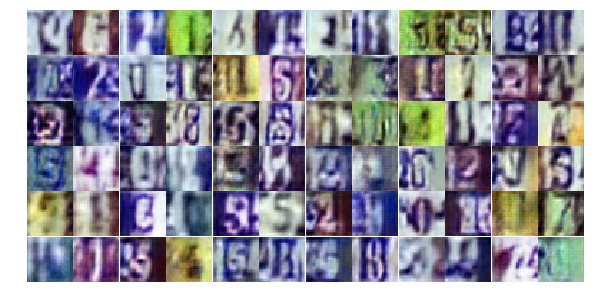

Epoch 7/20... Discriminator Loss: 1.2911... Generator Loss: 0.4369
Epoch 7/20... Discriminator Loss: 0.5880... Generator Loss: 1.2814
Epoch 7/20... Discriminator Loss: 0.9105... Generator Loss: 0.7584
Epoch 7/20... Discriminator Loss: 0.5681... Generator Loss: 1.4472
Epoch 7/20... Discriminator Loss: 0.4871... Generator Loss: 1.2566
Epoch 7/20... Discriminator Loss: 0.4798... Generator Loss: 1.6015
Epoch 7/20... Discriminator Loss: 0.5834... Generator Loss: 1.2757
Epoch 7/20... Discriminator Loss: 0.6436... Generator Loss: 1.1066
Epoch 7/20... Discriminator Loss: 0.5409... Generator Loss: 1.5586
Epoch 7/20... Discriminator Loss: 0.6717... Generator Loss: 1.8299


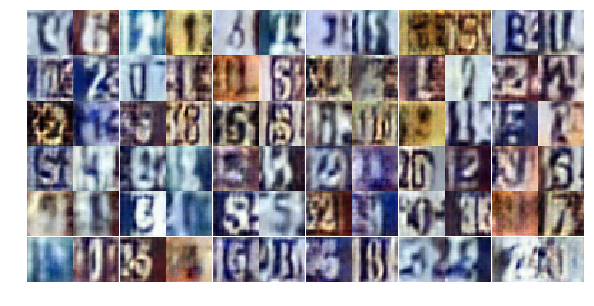

Epoch 7/20... Discriminator Loss: 1.0068... Generator Loss: 0.6481
Epoch 7/20... Discriminator Loss: 1.6014... Generator Loss: 0.3439
Epoch 7/20... Discriminator Loss: 0.3178... Generator Loss: 1.8233
Epoch 7/20... Discriminator Loss: 0.5525... Generator Loss: 1.2697
Epoch 7/20... Discriminator Loss: 0.7508... Generator Loss: 0.8629
Epoch 7/20... Discriminator Loss: 0.9818... Generator Loss: 0.6059
Epoch 7/20... Discriminator Loss: 0.5582... Generator Loss: 1.2421
Epoch 7/20... Discriminator Loss: 0.7164... Generator Loss: 0.9682
Epoch 7/20... Discriminator Loss: 0.7933... Generator Loss: 0.9664
Epoch 7/20... Discriminator Loss: 0.7670... Generator Loss: 2.6420


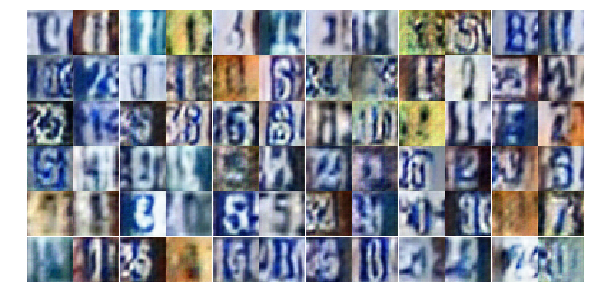

Epoch 7/20... Discriminator Loss: 1.1644... Generator Loss: 0.5330
Epoch 7/20... Discriminator Loss: 0.8694... Generator Loss: 1.3924
Epoch 7/20... Discriminator Loss: 0.5436... Generator Loss: 1.6013
Epoch 7/20... Discriminator Loss: 0.7097... Generator Loss: 1.3570
Epoch 7/20... Discriminator Loss: 0.5101... Generator Loss: 1.2891
Epoch 7/20... Discriminator Loss: 0.4791... Generator Loss: 2.3851
Epoch 7/20... Discriminator Loss: 0.5514... Generator Loss: 1.4430
Epoch 7/20... Discriminator Loss: 2.3541... Generator Loss: 0.1317
Epoch 7/20... Discriminator Loss: 0.3865... Generator Loss: 2.4107
Epoch 7/20... Discriminator Loss: 1.1005... Generator Loss: 0.7926


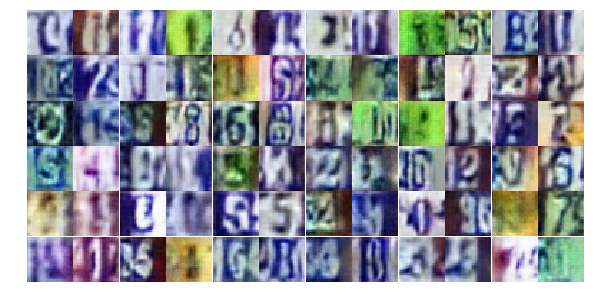

Epoch 7/20... Discriminator Loss: 0.5251... Generator Loss: 1.6347
Epoch 7/20... Discriminator Loss: 1.0089... Generator Loss: 0.6520
Epoch 7/20... Discriminator Loss: 0.7263... Generator Loss: 1.0707
Epoch 7/20... Discriminator Loss: 0.6298... Generator Loss: 1.2730
Epoch 7/20... Discriminator Loss: 0.6774... Generator Loss: 0.9504
Epoch 7/20... Discriminator Loss: 1.0344... Generator Loss: 0.5657
Epoch 7/20... Discriminator Loss: 1.0351... Generator Loss: 0.5866
Epoch 7/20... Discriminator Loss: 0.7744... Generator Loss: 1.3026
Epoch 7/20... Discriminator Loss: 0.8739... Generator Loss: 0.8996
Epoch 7/20... Discriminator Loss: 0.8414... Generator Loss: 0.7571


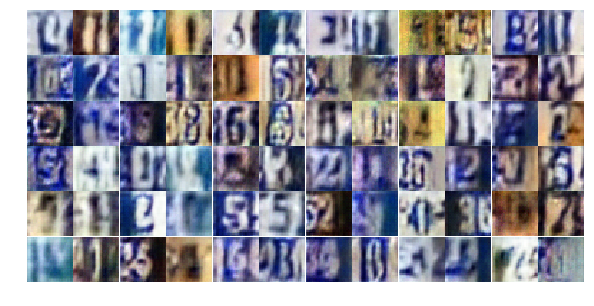

Epoch 7/20... Discriminator Loss: 0.7006... Generator Loss: 2.6079
Epoch 8/20... Discriminator Loss: 0.8965... Generator Loss: 0.6663
Epoch 8/20... Discriminator Loss: 1.1341... Generator Loss: 0.4974
Epoch 8/20... Discriminator Loss: 0.7294... Generator Loss: 1.0056
Epoch 8/20... Discriminator Loss: 0.7248... Generator Loss: 0.8446
Epoch 8/20... Discriminator Loss: 1.1770... Generator Loss: 0.5002
Epoch 8/20... Discriminator Loss: 1.6909... Generator Loss: 0.2974
Epoch 8/20... Discriminator Loss: 0.4903... Generator Loss: 1.5690
Epoch 8/20... Discriminator Loss: 1.0276... Generator Loss: 0.6622
Epoch 8/20... Discriminator Loss: 0.7312... Generator Loss: 0.8444


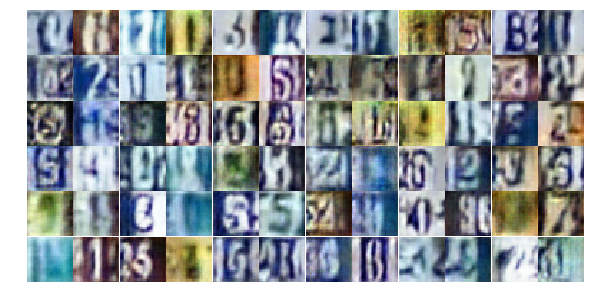

Epoch 8/20... Discriminator Loss: 0.5396... Generator Loss: 1.7376
Epoch 8/20... Discriminator Loss: 0.4592... Generator Loss: 1.3713
Epoch 8/20... Discriminator Loss: 1.1891... Generator Loss: 0.4610
Epoch 8/20... Discriminator Loss: 0.3849... Generator Loss: 1.9759
Epoch 8/20... Discriminator Loss: 1.1291... Generator Loss: 0.5562
Epoch 8/20... Discriminator Loss: 1.0337... Generator Loss: 3.2453
Epoch 8/20... Discriminator Loss: 0.4533... Generator Loss: 1.9592
Epoch 8/20... Discriminator Loss: 0.4042... Generator Loss: 1.6538
Epoch 8/20... Discriminator Loss: 1.0024... Generator Loss: 0.6371
Epoch 8/20... Discriminator Loss: 1.2387... Generator Loss: 0.4691


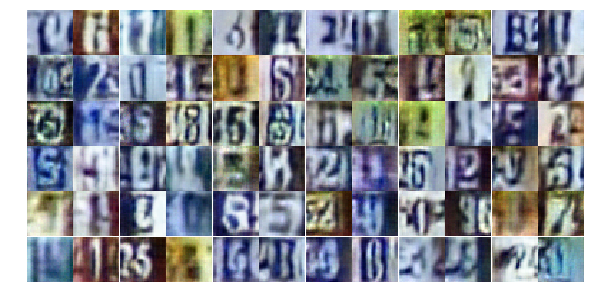

Epoch 8/20... Discriminator Loss: 0.5087... Generator Loss: 1.6555
Epoch 8/20... Discriminator Loss: 0.7003... Generator Loss: 0.9123
Epoch 8/20... Discriminator Loss: 0.7976... Generator Loss: 0.8051
Epoch 8/20... Discriminator Loss: 0.7297... Generator Loss: 1.0352
Epoch 8/20... Discriminator Loss: 0.3977... Generator Loss: 1.7575
Epoch 8/20... Discriminator Loss: 0.4183... Generator Loss: 1.8555
Epoch 8/20... Discriminator Loss: 0.5906... Generator Loss: 1.1567
Epoch 8/20... Discriminator Loss: 1.0181... Generator Loss: 0.5700
Epoch 8/20... Discriminator Loss: 1.5974... Generator Loss: 4.1853
Epoch 8/20... Discriminator Loss: 0.8796... Generator Loss: 1.0474


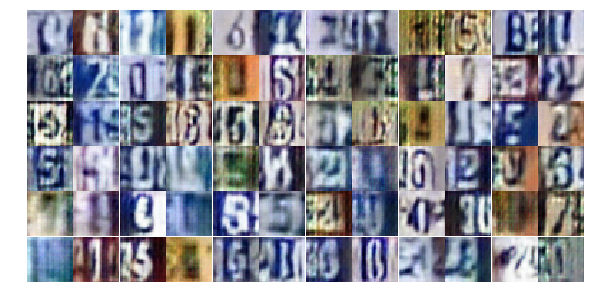

Epoch 8/20... Discriminator Loss: 0.9288... Generator Loss: 2.2413
Epoch 8/20... Discriminator Loss: 0.8945... Generator Loss: 0.7258
Epoch 8/20... Discriminator Loss: 0.6298... Generator Loss: 1.1502
Epoch 8/20... Discriminator Loss: 1.0120... Generator Loss: 0.6352
Epoch 8/20... Discriminator Loss: 0.6685... Generator Loss: 0.9537
Epoch 8/20... Discriminator Loss: 0.7179... Generator Loss: 0.9378
Epoch 8/20... Discriminator Loss: 0.5717... Generator Loss: 1.2356
Epoch 8/20... Discriminator Loss: 0.7245... Generator Loss: 1.0192
Epoch 8/20... Discriminator Loss: 0.5826... Generator Loss: 1.6604
Epoch 8/20... Discriminator Loss: 0.4797... Generator Loss: 1.3487


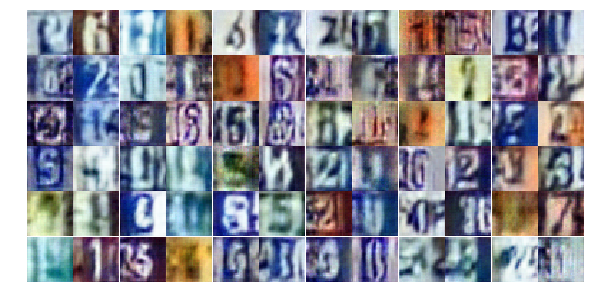

Epoch 8/20... Discriminator Loss: 0.5511... Generator Loss: 1.9763
Epoch 8/20... Discriminator Loss: 0.9237... Generator Loss: 0.7078
Epoch 8/20... Discriminator Loss: 0.6001... Generator Loss: 1.0686
Epoch 8/20... Discriminator Loss: 0.6898... Generator Loss: 0.9206
Epoch 8/20... Discriminator Loss: 1.2920... Generator Loss: 3.1109
Epoch 8/20... Discriminator Loss: 0.4984... Generator Loss: 1.2901
Epoch 8/20... Discriminator Loss: 0.9507... Generator Loss: 0.6099
Epoch 8/20... Discriminator Loss: 0.3824... Generator Loss: 1.7323
Epoch 8/20... Discriminator Loss: 0.5539... Generator Loss: 1.6562
Epoch 8/20... Discriminator Loss: 0.8764... Generator Loss: 2.2338


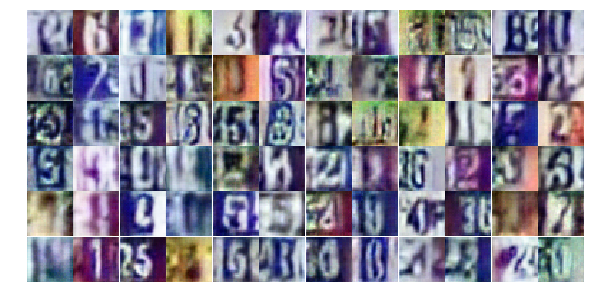

Epoch 8/20... Discriminator Loss: 0.8369... Generator Loss: 2.3105
Epoch 8/20... Discriminator Loss: 1.3236... Generator Loss: 0.4046
Epoch 8/20... Discriminator Loss: 0.4832... Generator Loss: 1.4281
Epoch 8/20... Discriminator Loss: 0.5346... Generator Loss: 1.1971
Epoch 8/20... Discriminator Loss: 0.6163... Generator Loss: 1.0632
Epoch 8/20... Discriminator Loss: 1.1871... Generator Loss: 0.4787
Epoch 8/20... Discriminator Loss: 0.7303... Generator Loss: 2.4520
Epoch 8/20... Discriminator Loss: 0.7198... Generator Loss: 1.4987
Epoch 9/20... Discriminator Loss: 1.2212... Generator Loss: 0.4635
Epoch 9/20... Discriminator Loss: 0.6464... Generator Loss: 1.0962


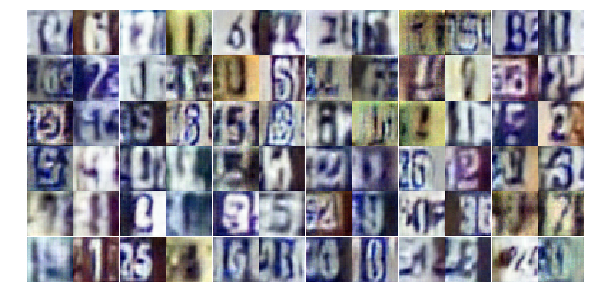

Epoch 9/20... Discriminator Loss: 0.7756... Generator Loss: 0.8198
Epoch 9/20... Discriminator Loss: 0.5438... Generator Loss: 1.5668
Epoch 9/20... Discriminator Loss: 0.7758... Generator Loss: 2.6539
Epoch 9/20... Discriminator Loss: 0.4262... Generator Loss: 1.6221
Epoch 9/20... Discriminator Loss: 1.0398... Generator Loss: 0.5762
Epoch 9/20... Discriminator Loss: 0.6140... Generator Loss: 2.6684
Epoch 9/20... Discriminator Loss: 0.6050... Generator Loss: 1.9181
Epoch 9/20... Discriminator Loss: 0.5057... Generator Loss: 1.2683
Epoch 9/20... Discriminator Loss: 1.0022... Generator Loss: 0.6611
Epoch 9/20... Discriminator Loss: 0.5801... Generator Loss: 1.4592


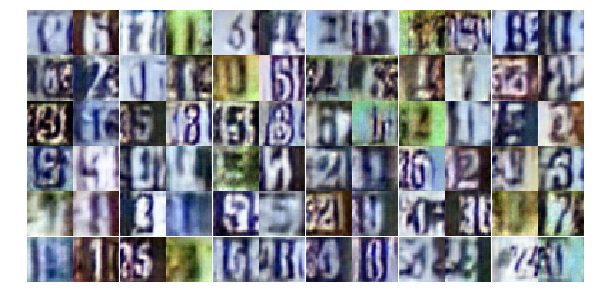

Epoch 9/20... Discriminator Loss: 0.8739... Generator Loss: 1.0090
Epoch 9/20... Discriminator Loss: 0.7348... Generator Loss: 2.3008
Epoch 9/20... Discriminator Loss: 0.8722... Generator Loss: 1.1261
Epoch 9/20... Discriminator Loss: 0.5862... Generator Loss: 1.1413
Epoch 9/20... Discriminator Loss: 0.5823... Generator Loss: 1.2272
Epoch 9/20... Discriminator Loss: 0.9461... Generator Loss: 1.4564
Epoch 9/20... Discriminator Loss: 1.0852... Generator Loss: 0.5535
Epoch 9/20... Discriminator Loss: 0.9892... Generator Loss: 0.6767
Epoch 9/20... Discriminator Loss: 1.2353... Generator Loss: 0.4563
Epoch 9/20... Discriminator Loss: 0.8626... Generator Loss: 0.7971


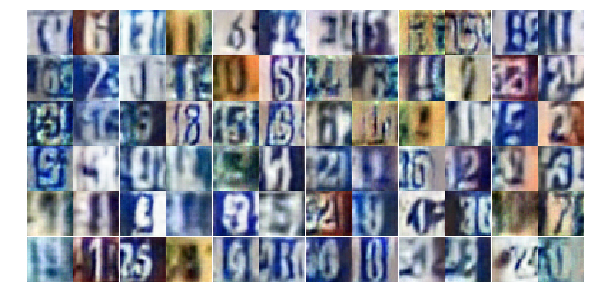

Epoch 9/20... Discriminator Loss: 0.8651... Generator Loss: 0.8176
Epoch 9/20... Discriminator Loss: 0.6254... Generator Loss: 1.3956
Epoch 9/20... Discriminator Loss: 0.6594... Generator Loss: 1.0403
Epoch 9/20... Discriminator Loss: 0.6405... Generator Loss: 1.1027
Epoch 9/20... Discriminator Loss: 0.4168... Generator Loss: 1.4365
Epoch 9/20... Discriminator Loss: 0.5468... Generator Loss: 1.4100
Epoch 9/20... Discriminator Loss: 1.5583... Generator Loss: 0.3747
Epoch 9/20... Discriminator Loss: 0.8902... Generator Loss: 0.8132
Epoch 9/20... Discriminator Loss: 0.6769... Generator Loss: 1.1724
Epoch 9/20... Discriminator Loss: 0.4472... Generator Loss: 1.5471


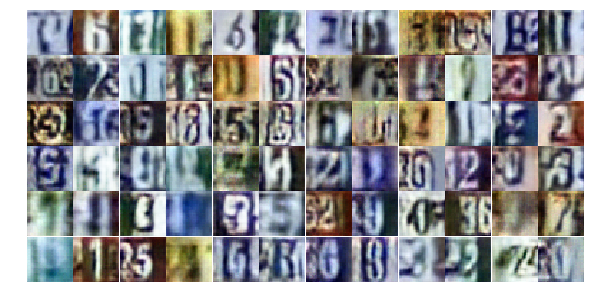

Epoch 9/20... Discriminator Loss: 0.6074... Generator Loss: 1.1897
Epoch 9/20... Discriminator Loss: 0.5885... Generator Loss: 1.1522
Epoch 9/20... Discriminator Loss: 0.7115... Generator Loss: 0.9404
Epoch 9/20... Discriminator Loss: 0.5782... Generator Loss: 1.3408
Epoch 9/20... Discriminator Loss: 0.6516... Generator Loss: 1.1964
Epoch 9/20... Discriminator Loss: 0.7100... Generator Loss: 1.0548
Epoch 9/20... Discriminator Loss: 0.5411... Generator Loss: 1.6175
Epoch 9/20... Discriminator Loss: 0.5189... Generator Loss: 1.3156
Epoch 9/20... Discriminator Loss: 1.1024... Generator Loss: 0.6281
Epoch 9/20... Discriminator Loss: 0.7310... Generator Loss: 0.8873


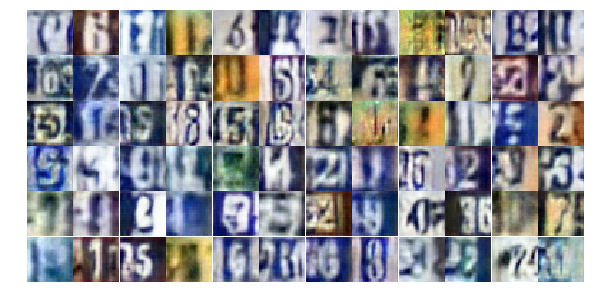

Epoch 9/20... Discriminator Loss: 0.5556... Generator Loss: 1.2283
Epoch 9/20... Discriminator Loss: 0.6479... Generator Loss: 1.1737
Epoch 9/20... Discriminator Loss: 0.8192... Generator Loss: 0.8890
Epoch 9/20... Discriminator Loss: 0.6674... Generator Loss: 1.0008
Epoch 9/20... Discriminator Loss: 0.5067... Generator Loss: 1.2159
Epoch 9/20... Discriminator Loss: 0.9279... Generator Loss: 0.7108
Epoch 9/20... Discriminator Loss: 0.7150... Generator Loss: 1.0044
Epoch 9/20... Discriminator Loss: 0.9703... Generator Loss: 0.6101
Epoch 9/20... Discriminator Loss: 0.4539... Generator Loss: 1.6091
Epoch 9/20... Discriminator Loss: 0.6996... Generator Loss: 2.6595


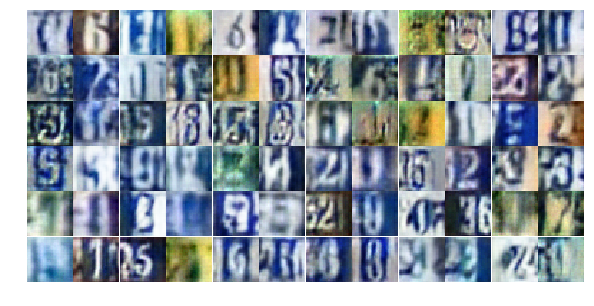

Epoch 9/20... Discriminator Loss: 0.8439... Generator Loss: 0.8576
Epoch 9/20... Discriminator Loss: 1.8015... Generator Loss: 3.7007
Epoch 9/20... Discriminator Loss: 0.7140... Generator Loss: 1.3220
Epoch 9/20... Discriminator Loss: 1.3817... Generator Loss: 0.4042
Epoch 9/20... Discriminator Loss: 0.6387... Generator Loss: 1.2491
Epoch 10/20... Discriminator Loss: 0.7217... Generator Loss: 1.1427
Epoch 10/20... Discriminator Loss: 0.5436... Generator Loss: 1.6212
Epoch 10/20... Discriminator Loss: 0.7354... Generator Loss: 1.7682
Epoch 10/20... Discriminator Loss: 0.7821... Generator Loss: 0.9111
Epoch 10/20... Discriminator Loss: 1.4009... Generator Loss: 0.3949


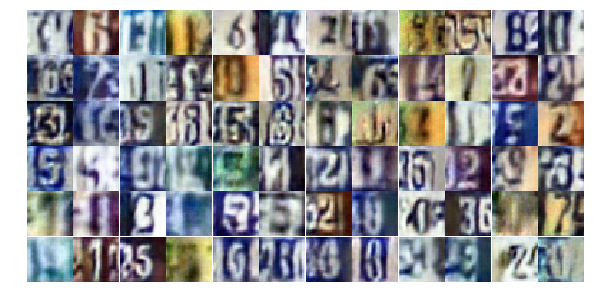

Epoch 10/20... Discriminator Loss: 0.7801... Generator Loss: 0.9949
Epoch 10/20... Discriminator Loss: 0.6955... Generator Loss: 0.9836
Epoch 10/20... Discriminator Loss: 0.8662... Generator Loss: 0.7471
Epoch 10/20... Discriminator Loss: 0.5981... Generator Loss: 1.9356
Epoch 10/20... Discriminator Loss: 0.5297... Generator Loss: 1.3680
Epoch 10/20... Discriminator Loss: 0.7225... Generator Loss: 0.9326
Epoch 10/20... Discriminator Loss: 0.5090... Generator Loss: 1.2275
Epoch 10/20... Discriminator Loss: 1.1056... Generator Loss: 0.5645
Epoch 10/20... Discriminator Loss: 1.0436... Generator Loss: 0.5961
Epoch 10/20... Discriminator Loss: 2.0655... Generator Loss: 0.2203


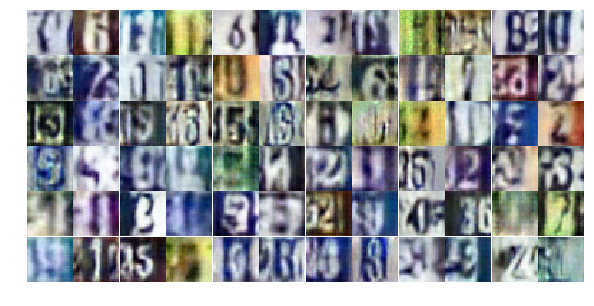

Epoch 10/20... Discriminator Loss: 1.0734... Generator Loss: 0.7137
Epoch 10/20... Discriminator Loss: 0.9175... Generator Loss: 0.7995
Epoch 10/20... Discriminator Loss: 0.6409... Generator Loss: 1.1581
Epoch 10/20... Discriminator Loss: 1.1278... Generator Loss: 0.5396
Epoch 10/20... Discriminator Loss: 0.7254... Generator Loss: 1.0849
Epoch 10/20... Discriminator Loss: 0.6187... Generator Loss: 1.1133
Epoch 10/20... Discriminator Loss: 0.6128... Generator Loss: 1.1184
Epoch 10/20... Discriminator Loss: 0.6371... Generator Loss: 1.8335
Epoch 10/20... Discriminator Loss: 0.6988... Generator Loss: 1.0008
Epoch 10/20... Discriminator Loss: 0.4374... Generator Loss: 2.1893


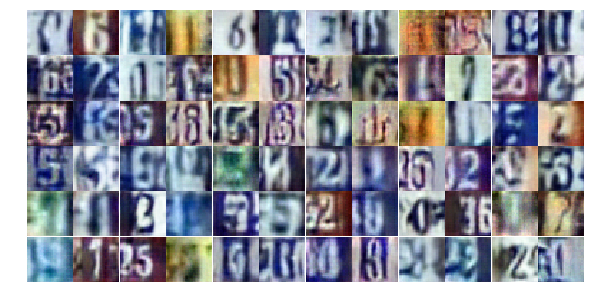

Epoch 10/20... Discriminator Loss: 0.8867... Generator Loss: 0.7005
Epoch 10/20... Discriminator Loss: 0.7117... Generator Loss: 0.9717
Epoch 10/20... Discriminator Loss: 0.6307... Generator Loss: 1.0829
Epoch 10/20... Discriminator Loss: 1.7006... Generator Loss: 3.8747
Epoch 10/20... Discriminator Loss: 1.0328... Generator Loss: 0.5813
Epoch 10/20... Discriminator Loss: 0.6024... Generator Loss: 1.8181
Epoch 10/20... Discriminator Loss: 0.4136... Generator Loss: 1.9263
Epoch 10/20... Discriminator Loss: 0.7519... Generator Loss: 1.0027
Epoch 10/20... Discriminator Loss: 0.7042... Generator Loss: 1.0139
Epoch 10/20... Discriminator Loss: 1.0666... Generator Loss: 0.5898


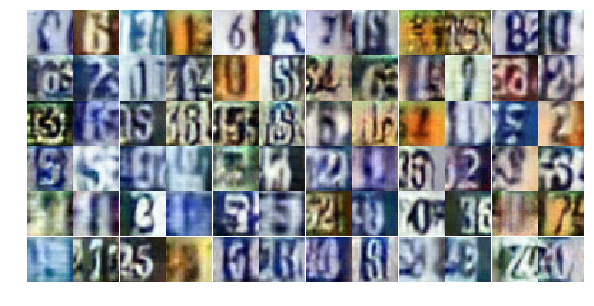

Epoch 10/20... Discriminator Loss: 0.8442... Generator Loss: 2.0114
Epoch 10/20... Discriminator Loss: 0.6493... Generator Loss: 1.1307
Epoch 10/20... Discriminator Loss: 0.5596... Generator Loss: 1.2859
Epoch 10/20... Discriminator Loss: 0.7422... Generator Loss: 0.8859
Epoch 10/20... Discriminator Loss: 0.5700... Generator Loss: 1.3034
Epoch 10/20... Discriminator Loss: 0.9303... Generator Loss: 0.6903
Epoch 10/20... Discriminator Loss: 0.7562... Generator Loss: 0.8979
Epoch 10/20... Discriminator Loss: 0.7513... Generator Loss: 0.9113
Epoch 10/20... Discriminator Loss: 0.6539... Generator Loss: 1.0151
Epoch 10/20... Discriminator Loss: 0.8839... Generator Loss: 1.3383


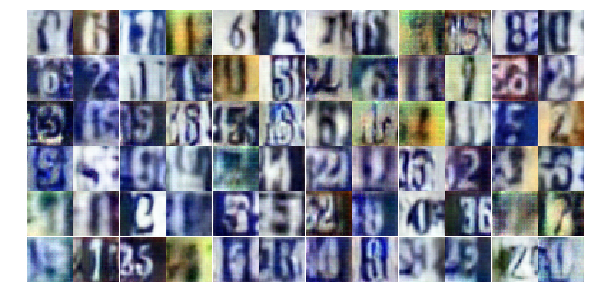

Epoch 10/20... Discriminator Loss: 0.8468... Generator Loss: 0.7920
Epoch 10/20... Discriminator Loss: 0.8432... Generator Loss: 0.8207
Epoch 10/20... Discriminator Loss: 0.7463... Generator Loss: 0.8827
Epoch 10/20... Discriminator Loss: 0.8302... Generator Loss: 0.8028
Epoch 10/20... Discriminator Loss: 0.5233... Generator Loss: 1.8741
Epoch 10/20... Discriminator Loss: 0.5015... Generator Loss: 1.7439
Epoch 10/20... Discriminator Loss: 0.6397... Generator Loss: 1.1640
Epoch 10/20... Discriminator Loss: 0.4337... Generator Loss: 1.4486
Epoch 10/20... Discriminator Loss: 1.1197... Generator Loss: 2.9672
Epoch 10/20... Discriminator Loss: 0.9745... Generator Loss: 2.6489


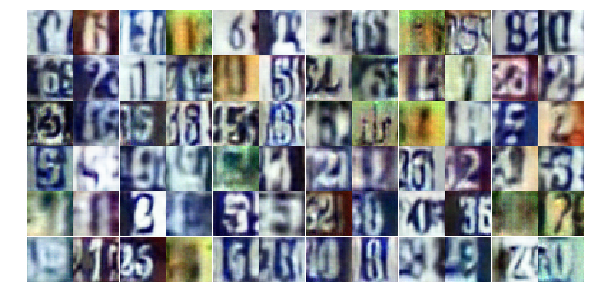

Epoch 10/20... Discriminator Loss: 0.6857... Generator Loss: 1.0771
Epoch 10/20... Discriminator Loss: 0.5603... Generator Loss: 1.2890
Epoch 10/20... Discriminator Loss: 0.5599... Generator Loss: 1.1741
Epoch 11/20... Discriminator Loss: 0.6573... Generator Loss: 1.1570
Epoch 11/20... Discriminator Loss: 0.6752... Generator Loss: 1.1268
Epoch 11/20... Discriminator Loss: 1.2811... Generator Loss: 0.4514
Epoch 11/20... Discriminator Loss: 0.7279... Generator Loss: 0.9150
Epoch 11/20... Discriminator Loss: 0.5406... Generator Loss: 1.4311
Epoch 11/20... Discriminator Loss: 1.2569... Generator Loss: 0.5911
Epoch 11/20... Discriminator Loss: 0.6862... Generator Loss: 1.6721


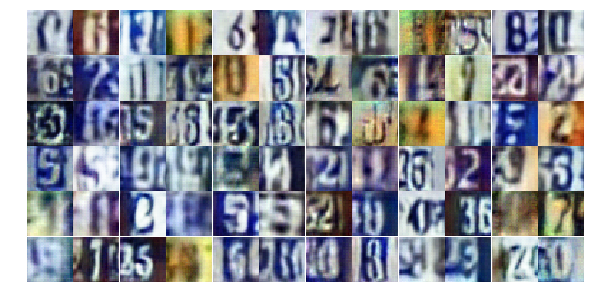

Epoch 11/20... Discriminator Loss: 0.5554... Generator Loss: 1.2035
Epoch 11/20... Discriminator Loss: 0.7750... Generator Loss: 0.9265
Epoch 11/20... Discriminator Loss: 0.4200... Generator Loss: 1.4514
Epoch 11/20... Discriminator Loss: 0.7439... Generator Loss: 0.8543
Epoch 11/20... Discriminator Loss: 0.7984... Generator Loss: 1.2945
Epoch 11/20... Discriminator Loss: 0.4212... Generator Loss: 1.6531
Epoch 11/20... Discriminator Loss: 0.7152... Generator Loss: 0.9098
Epoch 11/20... Discriminator Loss: 0.3209... Generator Loss: 2.0556
Epoch 11/20... Discriminator Loss: 1.1073... Generator Loss: 0.5522
Epoch 11/20... Discriminator Loss: 1.2663... Generator Loss: 0.4781


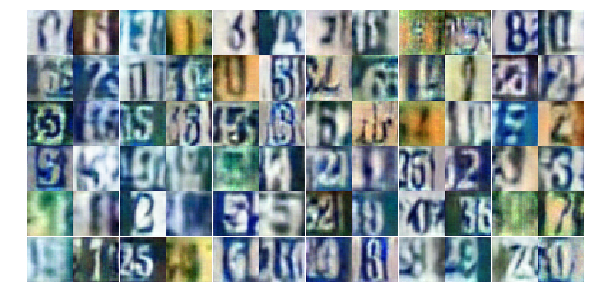

Epoch 11/20... Discriminator Loss: 0.7342... Generator Loss: 1.1119
Epoch 11/20... Discriminator Loss: 0.5194... Generator Loss: 2.4554
Epoch 11/20... Discriminator Loss: 0.9128... Generator Loss: 0.6962
Epoch 11/20... Discriminator Loss: 0.8387... Generator Loss: 0.7727
Epoch 11/20... Discriminator Loss: 0.3590... Generator Loss: 2.2632
Epoch 11/20... Discriminator Loss: 0.3736... Generator Loss: 1.7328
Epoch 11/20... Discriminator Loss: 0.6488... Generator Loss: 1.0928
Epoch 11/20... Discriminator Loss: 0.9243... Generator Loss: 0.7549
Epoch 11/20... Discriminator Loss: 0.4066... Generator Loss: 1.4522
Epoch 11/20... Discriminator Loss: 0.8747... Generator Loss: 0.7658


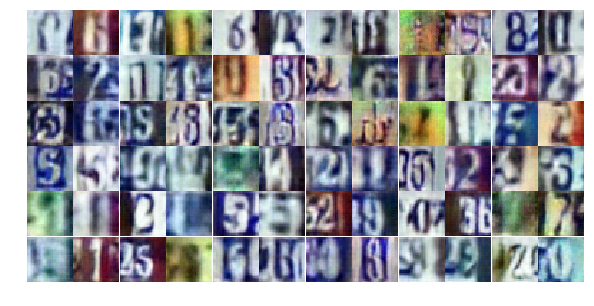

Epoch 11/20... Discriminator Loss: 0.6608... Generator Loss: 1.4130
Epoch 11/20... Discriminator Loss: 0.4837... Generator Loss: 1.5458
Epoch 11/20... Discriminator Loss: 1.1973... Generator Loss: 0.5022
Epoch 11/20... Discriminator Loss: 0.6279... Generator Loss: 1.2762
Epoch 11/20... Discriminator Loss: 0.8174... Generator Loss: 0.7896
Epoch 11/20... Discriminator Loss: 1.1760... Generator Loss: 0.5142
Epoch 11/20... Discriminator Loss: 1.1546... Generator Loss: 0.5159
Epoch 11/20... Discriminator Loss: 0.9575... Generator Loss: 0.6725
Epoch 11/20... Discriminator Loss: 0.7710... Generator Loss: 0.8723
Epoch 11/20... Discriminator Loss: 1.6034... Generator Loss: 0.3028


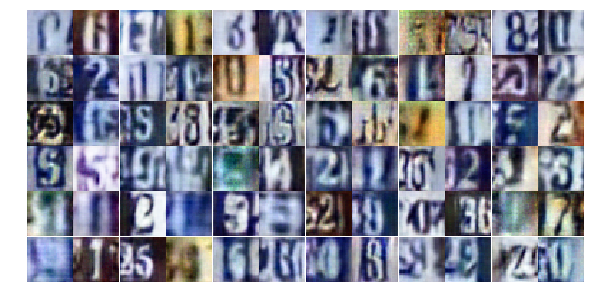

Epoch 11/20... Discriminator Loss: 0.5222... Generator Loss: 1.2961
Epoch 11/20... Discriminator Loss: 0.6586... Generator Loss: 1.4239
Epoch 11/20... Discriminator Loss: 0.8411... Generator Loss: 0.8420
Epoch 11/20... Discriminator Loss: 0.6365... Generator Loss: 1.1831
Epoch 11/20... Discriminator Loss: 0.7104... Generator Loss: 1.2970
Epoch 11/20... Discriminator Loss: 0.5918... Generator Loss: 1.1203
Epoch 11/20... Discriminator Loss: 0.2862... Generator Loss: 2.1554
Epoch 11/20... Discriminator Loss: 0.6488... Generator Loss: 1.1608
Epoch 11/20... Discriminator Loss: 1.3322... Generator Loss: 0.4142
Epoch 11/20... Discriminator Loss: 0.5662... Generator Loss: 1.1031


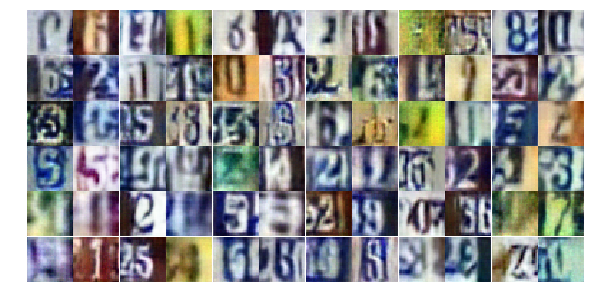

Epoch 11/20... Discriminator Loss: 0.7991... Generator Loss: 0.8434
Epoch 11/20... Discriminator Loss: 0.4748... Generator Loss: 1.4781
Epoch 11/20... Discriminator Loss: 0.6711... Generator Loss: 1.4698
Epoch 11/20... Discriminator Loss: 1.1364... Generator Loss: 0.5254
Epoch 11/20... Discriminator Loss: 1.4994... Generator Loss: 0.3419
Epoch 11/20... Discriminator Loss: 3.7213... Generator Loss: 0.0496
Epoch 11/20... Discriminator Loss: 0.9039... Generator Loss: 0.9664
Epoch 11/20... Discriminator Loss: 0.6111... Generator Loss: 1.5090
Epoch 11/20... Discriminator Loss: 1.0323... Generator Loss: 0.6660
Epoch 11/20... Discriminator Loss: 0.7543... Generator Loss: 1.0161


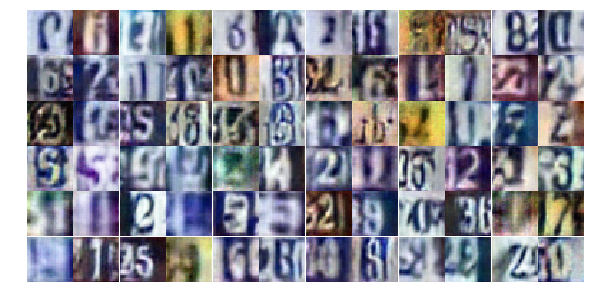

Epoch 12/20... Discriminator Loss: 1.0574... Generator Loss: 0.6553
Epoch 12/20... Discriminator Loss: 0.7590... Generator Loss: 0.9226
Epoch 12/20... Discriminator Loss: 1.1497... Generator Loss: 0.5259
Epoch 12/20... Discriminator Loss: 0.5338... Generator Loss: 1.3678
Epoch 12/20... Discriminator Loss: 0.6061... Generator Loss: 1.5564
Epoch 12/20... Discriminator Loss: 0.8795... Generator Loss: 0.7770
Epoch 12/20... Discriminator Loss: 0.7454... Generator Loss: 0.9831
Epoch 12/20... Discriminator Loss: 0.6745... Generator Loss: 1.1833
Epoch 12/20... Discriminator Loss: 0.7296... Generator Loss: 1.1341
Epoch 12/20... Discriminator Loss: 1.0746... Generator Loss: 0.6131


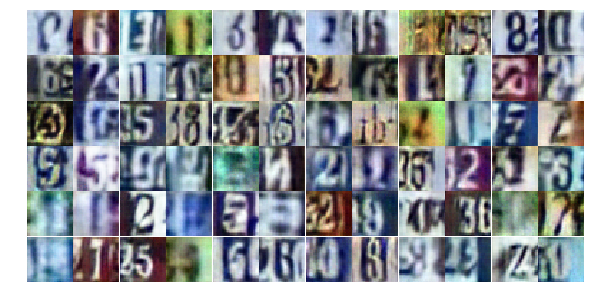

Epoch 12/20... Discriminator Loss: 0.5875... Generator Loss: 1.1187
Epoch 12/20... Discriminator Loss: 0.7909... Generator Loss: 0.8206
Epoch 12/20... Discriminator Loss: 0.5036... Generator Loss: 1.5339
Epoch 12/20... Discriminator Loss: 0.7192... Generator Loss: 1.1434
Epoch 12/20... Discriminator Loss: 0.5072... Generator Loss: 1.5505
Epoch 12/20... Discriminator Loss: 0.9297... Generator Loss: 0.9102
Epoch 12/20... Discriminator Loss: 1.6677... Generator Loss: 0.2762
Epoch 12/20... Discriminator Loss: 0.4470... Generator Loss: 1.7574
Epoch 12/20... Discriminator Loss: 0.5878... Generator Loss: 1.0937
Epoch 12/20... Discriminator Loss: 0.8100... Generator Loss: 0.8170


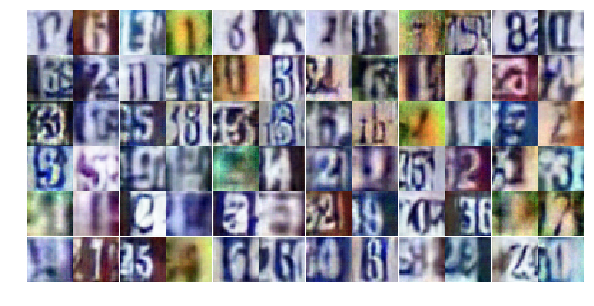

Epoch 12/20... Discriminator Loss: 0.4350... Generator Loss: 1.3769
Epoch 12/20... Discriminator Loss: 0.4569... Generator Loss: 1.9462
Epoch 12/20... Discriminator Loss: 0.6263... Generator Loss: 1.3958
Epoch 12/20... Discriminator Loss: 0.4398... Generator Loss: 1.8248
Epoch 12/20... Discriminator Loss: 0.4103... Generator Loss: 1.7417
Epoch 12/20... Discriminator Loss: 0.4559... Generator Loss: 1.6880
Epoch 12/20... Discriminator Loss: 0.9084... Generator Loss: 0.7214
Epoch 12/20... Discriminator Loss: 0.3996... Generator Loss: 1.5777
Epoch 12/20... Discriminator Loss: 0.4998... Generator Loss: 1.4994
Epoch 12/20... Discriminator Loss: 0.4961... Generator Loss: 1.4968


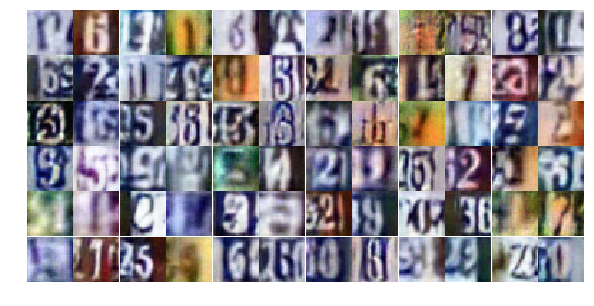

Epoch 12/20... Discriminator Loss: 0.6877... Generator Loss: 1.0555
Epoch 12/20... Discriminator Loss: 0.9476... Generator Loss: 0.7238
Epoch 12/20... Discriminator Loss: 1.0841... Generator Loss: 0.6062
Epoch 12/20... Discriminator Loss: 1.7308... Generator Loss: 0.2583
Epoch 12/20... Discriminator Loss: 0.6144... Generator Loss: 1.8700
Epoch 12/20... Discriminator Loss: 1.0113... Generator Loss: 0.6518
Epoch 12/20... Discriminator Loss: 0.9040... Generator Loss: 0.7833
Epoch 12/20... Discriminator Loss: 0.8343... Generator Loss: 0.8985
Epoch 12/20... Discriminator Loss: 0.8425... Generator Loss: 0.8234
Epoch 12/20... Discriminator Loss: 0.3251... Generator Loss: 2.2826


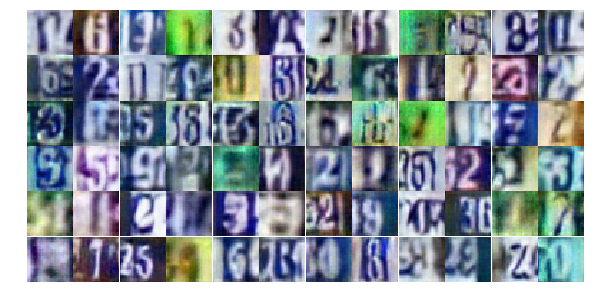

Epoch 12/20... Discriminator Loss: 0.6284... Generator Loss: 3.2054
Epoch 12/20... Discriminator Loss: 0.5684... Generator Loss: 1.1586
Epoch 12/20... Discriminator Loss: 0.5206... Generator Loss: 2.1303
Epoch 12/20... Discriminator Loss: 1.0700... Generator Loss: 0.5798
Epoch 12/20... Discriminator Loss: 0.7722... Generator Loss: 0.8305
Epoch 12/20... Discriminator Loss: 0.9519... Generator Loss: 0.6751
Epoch 12/20... Discriminator Loss: 0.5962... Generator Loss: 1.1340
Epoch 12/20... Discriminator Loss: 0.8611... Generator Loss: 0.8359
Epoch 12/20... Discriminator Loss: 0.6506... Generator Loss: 1.4575
Epoch 12/20... Discriminator Loss: 0.5214... Generator Loss: 1.4495


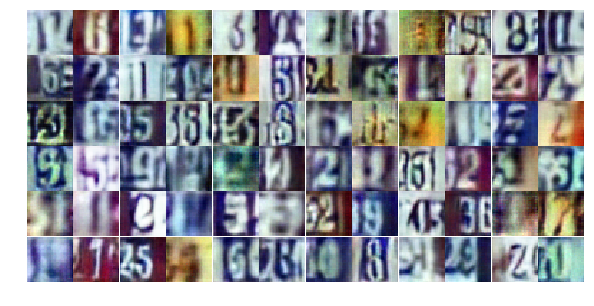

Epoch 12/20... Discriminator Loss: 1.0222... Generator Loss: 0.6543
Epoch 12/20... Discriminator Loss: 0.8879... Generator Loss: 0.7607
Epoch 12/20... Discriminator Loss: 0.6357... Generator Loss: 1.2128
Epoch 12/20... Discriminator Loss: 2.1028... Generator Loss: 0.2588
Epoch 12/20... Discriminator Loss: 0.7268... Generator Loss: 1.1425
Epoch 12/20... Discriminator Loss: 1.0143... Generator Loss: 0.7538
Epoch 12/20... Discriminator Loss: 0.9878... Generator Loss: 0.7690
Epoch 13/20... Discriminator Loss: 0.5511... Generator Loss: 1.2955
Epoch 13/20... Discriminator Loss: 0.4819... Generator Loss: 1.3958
Epoch 13/20... Discriminator Loss: 1.1703... Generator Loss: 0.5118


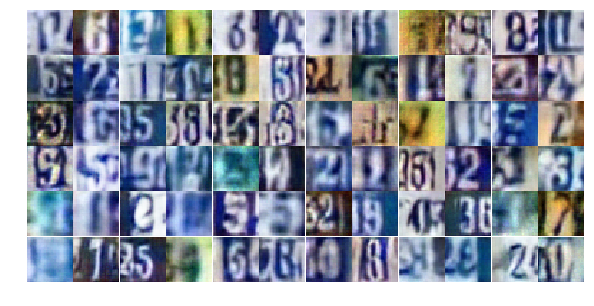

Epoch 13/20... Discriminator Loss: 0.7716... Generator Loss: 1.0408
Epoch 13/20... Discriminator Loss: 0.5442... Generator Loss: 1.8105
Epoch 13/20... Discriminator Loss: 1.4706... Generator Loss: 0.3731
Epoch 13/20... Discriminator Loss: 1.2090... Generator Loss: 0.5031
Epoch 13/20... Discriminator Loss: 0.6041... Generator Loss: 1.3549
Epoch 13/20... Discriminator Loss: 0.5457... Generator Loss: 1.3329
Epoch 13/20... Discriminator Loss: 0.4062... Generator Loss: 1.6102
Epoch 13/20... Discriminator Loss: 0.7069... Generator Loss: 0.9641
Epoch 13/20... Discriminator Loss: 1.1135... Generator Loss: 0.5849
Epoch 13/20... Discriminator Loss: 0.6235... Generator Loss: 1.2151


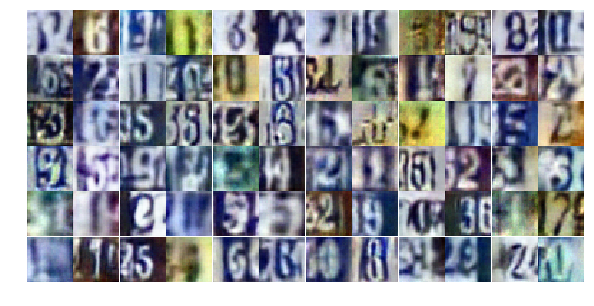

Epoch 13/20... Discriminator Loss: 0.5433... Generator Loss: 1.2654
Epoch 13/20... Discriminator Loss: 0.6197... Generator Loss: 1.0472
Epoch 13/20... Discriminator Loss: 1.2192... Generator Loss: 0.4997
Epoch 13/20... Discriminator Loss: 0.8285... Generator Loss: 0.9593
Epoch 13/20... Discriminator Loss: 0.5498... Generator Loss: 2.1159
Epoch 13/20... Discriminator Loss: 0.8775... Generator Loss: 0.8427
Epoch 13/20... Discriminator Loss: 0.6447... Generator Loss: 1.0839
Epoch 13/20... Discriminator Loss: 0.9827... Generator Loss: 0.7081
Epoch 13/20... Discriminator Loss: 0.5734... Generator Loss: 1.3439
Epoch 13/20... Discriminator Loss: 1.0332... Generator Loss: 0.5903


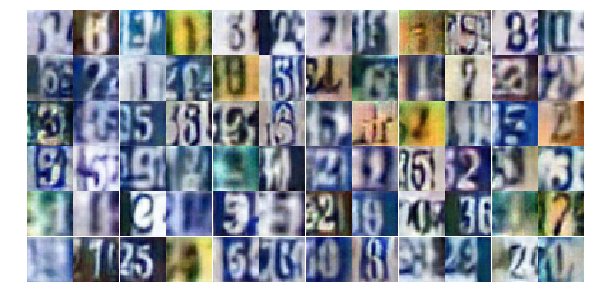

Epoch 13/20... Discriminator Loss: 0.6349... Generator Loss: 1.0279
Epoch 13/20... Discriminator Loss: 1.1567... Generator Loss: 0.5373
Epoch 13/20... Discriminator Loss: 0.7365... Generator Loss: 2.2970
Epoch 13/20... Discriminator Loss: 0.9543... Generator Loss: 0.6939
Epoch 13/20... Discriminator Loss: 0.7945... Generator Loss: 0.9026
Epoch 13/20... Discriminator Loss: 0.6235... Generator Loss: 1.1367
Epoch 13/20... Discriminator Loss: 1.0651... Generator Loss: 1.7493
Epoch 13/20... Discriminator Loss: 0.5167... Generator Loss: 1.5967
Epoch 13/20... Discriminator Loss: 0.8340... Generator Loss: 0.7813
Epoch 13/20... Discriminator Loss: 0.6314... Generator Loss: 1.3797


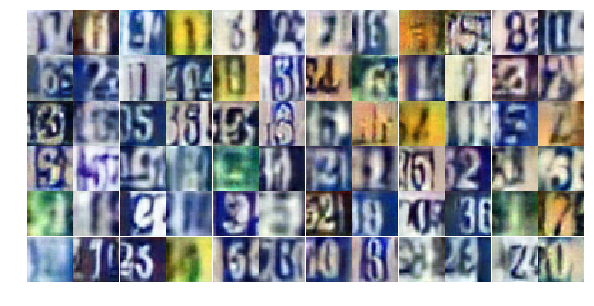

Epoch 13/20... Discriminator Loss: 1.1398... Generator Loss: 0.5488
Epoch 13/20... Discriminator Loss: 0.8920... Generator Loss: 0.7919
Epoch 13/20... Discriminator Loss: 1.3377... Generator Loss: 0.4311
Epoch 13/20... Discriminator Loss: 0.9098... Generator Loss: 0.8611
Epoch 13/20... Discriminator Loss: 0.5276... Generator Loss: 1.4741
Epoch 13/20... Discriminator Loss: 0.4517... Generator Loss: 1.8545
Epoch 13/20... Discriminator Loss: 0.4164... Generator Loss: 1.4112
Epoch 13/20... Discriminator Loss: 0.7076... Generator Loss: 1.1043
Epoch 13/20... Discriminator Loss: 0.7343... Generator Loss: 0.9660
Epoch 13/20... Discriminator Loss: 0.7846... Generator Loss: 0.8159


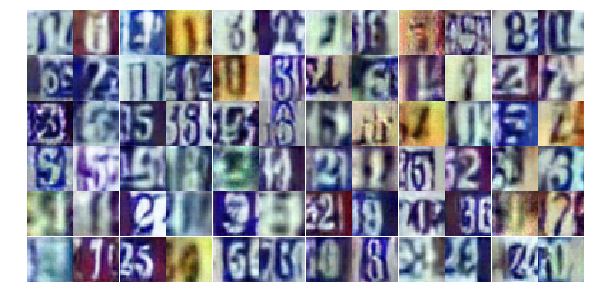

Epoch 13/20... Discriminator Loss: 0.6276... Generator Loss: 1.1201
Epoch 13/20... Discriminator Loss: 1.4676... Generator Loss: 1.0577
Epoch 13/20... Discriminator Loss: 0.8905... Generator Loss: 0.7514
Epoch 13/20... Discriminator Loss: 0.5685... Generator Loss: 1.2561
Epoch 13/20... Discriminator Loss: 0.9614... Generator Loss: 0.6664
Epoch 13/20... Discriminator Loss: 0.6976... Generator Loss: 0.9645
Epoch 13/20... Discriminator Loss: 0.6273... Generator Loss: 1.2019
Epoch 13/20... Discriminator Loss: 0.7420... Generator Loss: 0.8412
Epoch 13/20... Discriminator Loss: 1.0786... Generator Loss: 0.5707
Epoch 13/20... Discriminator Loss: 1.1590... Generator Loss: 0.5313


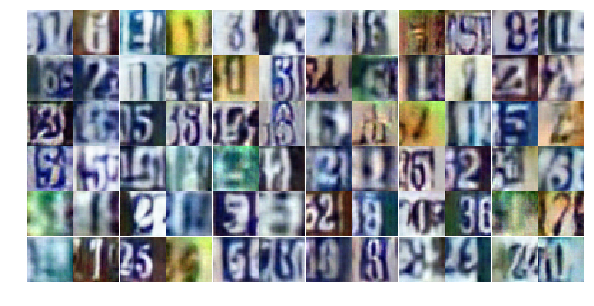

Epoch 13/20... Discriminator Loss: 0.3558... Generator Loss: 2.1700
Epoch 13/20... Discriminator Loss: 1.6410... Generator Loss: 0.3182
Epoch 13/20... Discriminator Loss: 0.7109... Generator Loss: 1.1933
Epoch 13/20... Discriminator Loss: 0.9854... Generator Loss: 0.6008
Epoch 14/20... Discriminator Loss: 1.1317... Generator Loss: 0.5152
Epoch 14/20... Discriminator Loss: 0.7127... Generator Loss: 1.0312
Epoch 14/20... Discriminator Loss: 0.8667... Generator Loss: 0.7823
Epoch 14/20... Discriminator Loss: 0.6479... Generator Loss: 1.1974
Epoch 14/20... Discriminator Loss: 0.5917... Generator Loss: 1.1465
Epoch 14/20... Discriminator Loss: 1.0097... Generator Loss: 0.6752


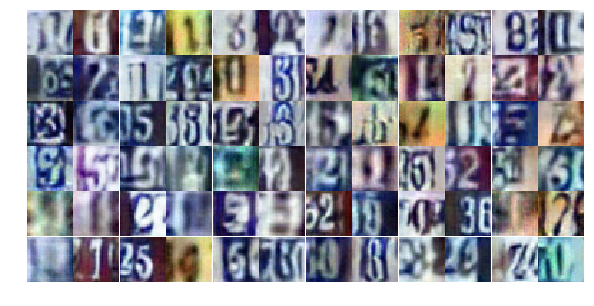

Epoch 14/20... Discriminator Loss: 1.1347... Generator Loss: 2.8487
Epoch 14/20... Discriminator Loss: 0.6152... Generator Loss: 1.0400
Epoch 14/20... Discriminator Loss: 0.7664... Generator Loss: 0.8640
Epoch 14/20... Discriminator Loss: 1.3279... Generator Loss: 0.4188
Epoch 14/20... Discriminator Loss: 1.3228... Generator Loss: 0.4352
Epoch 14/20... Discriminator Loss: 0.4660... Generator Loss: 1.4821
Epoch 14/20... Discriminator Loss: 0.5716... Generator Loss: 1.0950
Epoch 14/20... Discriminator Loss: 1.3688... Generator Loss: 0.4418
Epoch 14/20... Discriminator Loss: 1.1793... Generator Loss: 0.5335
Epoch 14/20... Discriminator Loss: 1.3658... Generator Loss: 0.4055


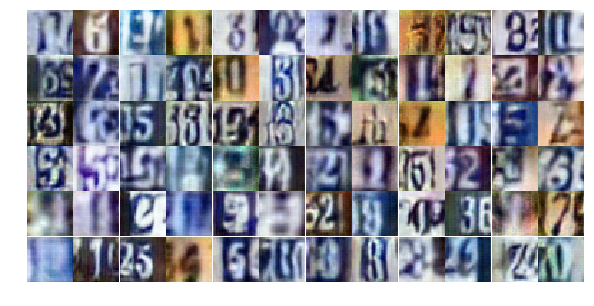

Epoch 14/20... Discriminator Loss: 0.4888... Generator Loss: 1.2555
Epoch 14/20... Discriminator Loss: 0.6909... Generator Loss: 2.4370
Epoch 14/20... Discriminator Loss: 1.0239... Generator Loss: 0.6365
Epoch 14/20... Discriminator Loss: 0.6496... Generator Loss: 1.0735
Epoch 14/20... Discriminator Loss: 0.8260... Generator Loss: 1.1027
Epoch 14/20... Discriminator Loss: 0.8598... Generator Loss: 0.7668
Epoch 14/20... Discriminator Loss: 0.9586... Generator Loss: 0.6793
Epoch 14/20... Discriminator Loss: 0.8941... Generator Loss: 0.7623
Epoch 14/20... Discriminator Loss: 0.5665... Generator Loss: 1.3321
Epoch 14/20... Discriminator Loss: 0.8120... Generator Loss: 0.9093


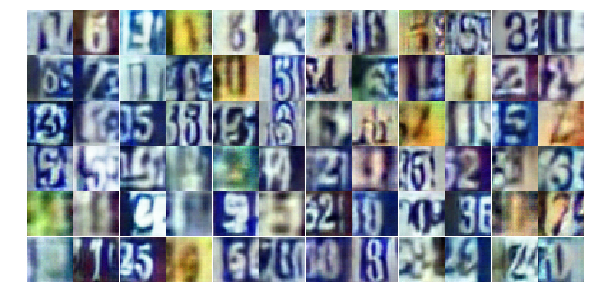

Epoch 14/20... Discriminator Loss: 1.1469... Generator Loss: 0.7435
Epoch 14/20... Discriminator Loss: 0.4721... Generator Loss: 1.3708
Epoch 14/20... Discriminator Loss: 0.4477... Generator Loss: 1.5454
Epoch 14/20... Discriminator Loss: 0.4556... Generator Loss: 1.5869
Epoch 14/20... Discriminator Loss: 0.5973... Generator Loss: 1.2579
Epoch 14/20... Discriminator Loss: 0.8825... Generator Loss: 0.8418
Epoch 14/20... Discriminator Loss: 0.7319... Generator Loss: 0.9289
Epoch 14/20... Discriminator Loss: 0.4568... Generator Loss: 1.5391
Epoch 14/20... Discriminator Loss: 0.3893... Generator Loss: 2.3082
Epoch 14/20... Discriminator Loss: 1.6813... Generator Loss: 0.5325


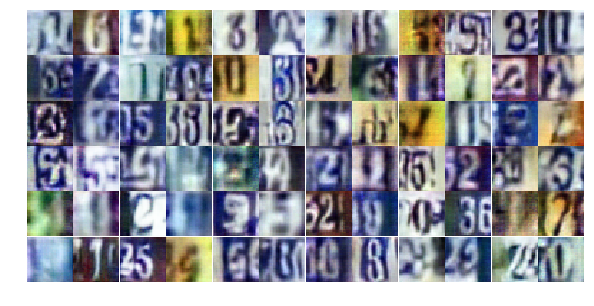

Epoch 14/20... Discriminator Loss: 1.2327... Generator Loss: 0.4912
Epoch 14/20... Discriminator Loss: 0.8833... Generator Loss: 0.7956
Epoch 14/20... Discriminator Loss: 0.9351... Generator Loss: 0.7293
Epoch 14/20... Discriminator Loss: 0.9840... Generator Loss: 0.7017
Epoch 14/20... Discriminator Loss: 0.8819... Generator Loss: 0.7615
Epoch 14/20... Discriminator Loss: 0.6273... Generator Loss: 1.1743
Epoch 14/20... Discriminator Loss: 0.6173... Generator Loss: 1.1947
Epoch 14/20... Discriminator Loss: 0.5344... Generator Loss: 1.1582
Epoch 14/20... Discriminator Loss: 1.2453... Generator Loss: 0.5250
Epoch 14/20... Discriminator Loss: 1.3217... Generator Loss: 0.4172


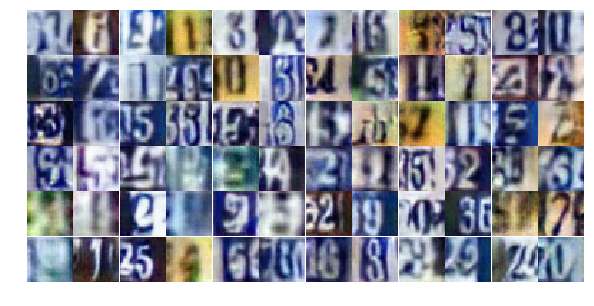

Epoch 14/20... Discriminator Loss: 0.8017... Generator Loss: 2.3691
Epoch 14/20... Discriminator Loss: 1.1995... Generator Loss: 0.4571
Epoch 14/20... Discriminator Loss: 0.4877... Generator Loss: 1.3951
Epoch 14/20... Discriminator Loss: 1.0156... Generator Loss: 0.6315
Epoch 14/20... Discriminator Loss: 0.6497... Generator Loss: 1.1026
Epoch 14/20... Discriminator Loss: 0.5352... Generator Loss: 1.9708
Epoch 14/20... Discriminator Loss: 0.6512... Generator Loss: 1.6460
Epoch 14/20... Discriminator Loss: 0.8345... Generator Loss: 0.7397
Epoch 14/20... Discriminator Loss: 1.3133... Generator Loss: 0.4676
Epoch 14/20... Discriminator Loss: 1.3630... Generator Loss: 0.4102


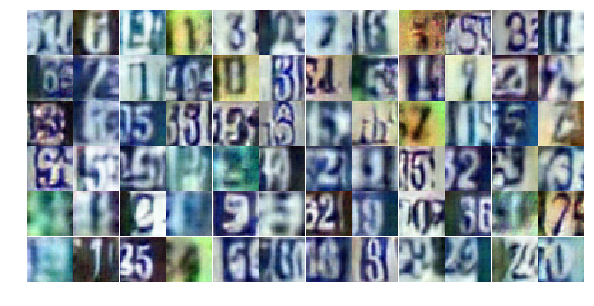

Epoch 14/20... Discriminator Loss: 0.7239... Generator Loss: 1.1002
Epoch 14/20... Discriminator Loss: 0.9112... Generator Loss: 0.7811
Epoch 15/20... Discriminator Loss: 0.7660... Generator Loss: 0.9783
Epoch 15/20... Discriminator Loss: 0.5042... Generator Loss: 1.6841
Epoch 15/20... Discriminator Loss: 0.7179... Generator Loss: 0.9179
Epoch 15/20... Discriminator Loss: 0.8740... Generator Loss: 0.7980
Epoch 15/20... Discriminator Loss: 1.0647... Generator Loss: 0.5997
Epoch 15/20... Discriminator Loss: 0.6450... Generator Loss: 1.1128
Epoch 15/20... Discriminator Loss: 1.1897... Generator Loss: 0.5884
Epoch 15/20... Discriminator Loss: 0.7600... Generator Loss: 0.8290


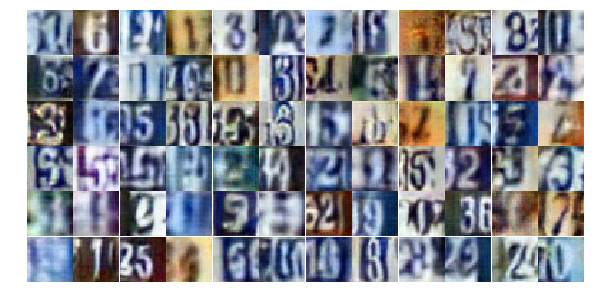

Epoch 15/20... Discriminator Loss: 0.7330... Generator Loss: 0.9589
Epoch 15/20... Discriminator Loss: 0.5953... Generator Loss: 2.0181
Epoch 15/20... Discriminator Loss: 0.8344... Generator Loss: 0.8206
Epoch 15/20... Discriminator Loss: 0.6847... Generator Loss: 1.1561
Epoch 15/20... Discriminator Loss: 0.8970... Generator Loss: 0.8275
Epoch 15/20... Discriminator Loss: 0.5361... Generator Loss: 1.3127
Epoch 15/20... Discriminator Loss: 1.5508... Generator Loss: 0.3240
Epoch 15/20... Discriminator Loss: 1.6272... Generator Loss: 2.4851
Epoch 15/20... Discriminator Loss: 0.8833... Generator Loss: 2.3558
Epoch 15/20... Discriminator Loss: 0.8335... Generator Loss: 0.8586


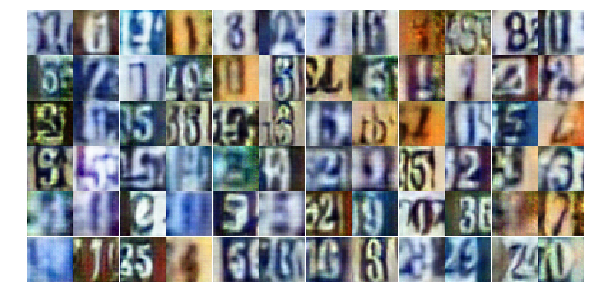

Epoch 15/20... Discriminator Loss: 1.1276... Generator Loss: 0.5747
Epoch 15/20... Discriminator Loss: 0.5664... Generator Loss: 1.3308
Epoch 15/20... Discriminator Loss: 0.6154... Generator Loss: 1.2466
Epoch 15/20... Discriminator Loss: 0.8465... Generator Loss: 0.8016
Epoch 15/20... Discriminator Loss: 1.2419... Generator Loss: 0.5042
Epoch 15/20... Discriminator Loss: 0.6348... Generator Loss: 1.2055
Epoch 15/20... Discriminator Loss: 0.7936... Generator Loss: 0.9956
Epoch 15/20... Discriminator Loss: 0.7288... Generator Loss: 0.8772
Epoch 15/20... Discriminator Loss: 0.5725... Generator Loss: 1.7151
Epoch 15/20... Discriminator Loss: 1.5030... Generator Loss: 0.3379


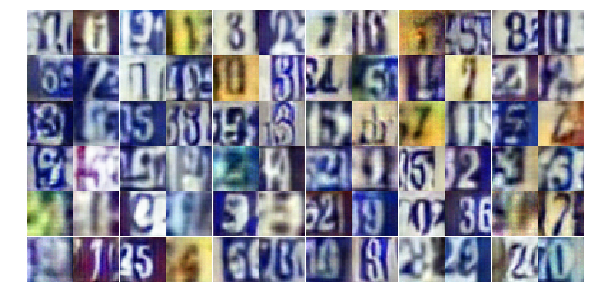

Epoch 15/20... Discriminator Loss: 0.8037... Generator Loss: 0.9005
Epoch 15/20... Discriminator Loss: 0.7822... Generator Loss: 1.0092
Epoch 15/20... Discriminator Loss: 0.5251... Generator Loss: 1.2122
Epoch 15/20... Discriminator Loss: 0.5668... Generator Loss: 1.6090
Epoch 15/20... Discriminator Loss: 0.5640... Generator Loss: 1.1781
Epoch 15/20... Discriminator Loss: 1.2696... Generator Loss: 2.7822
Epoch 15/20... Discriminator Loss: 0.5441... Generator Loss: 1.5243
Epoch 15/20... Discriminator Loss: 0.5966... Generator Loss: 1.1575
Epoch 15/20... Discriminator Loss: 0.6816... Generator Loss: 0.9636
Epoch 15/20... Discriminator Loss: 0.5865... Generator Loss: 1.3026


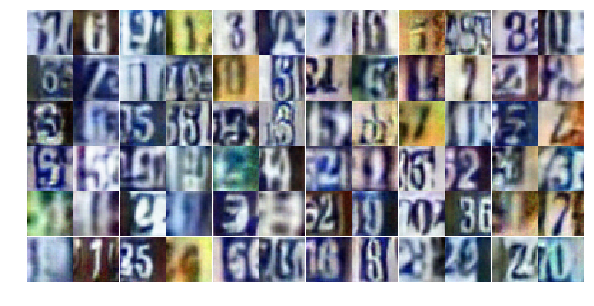

Epoch 15/20... Discriminator Loss: 0.5969... Generator Loss: 1.0973
Epoch 15/20... Discriminator Loss: 1.2939... Generator Loss: 0.4866
Epoch 15/20... Discriminator Loss: 0.6438... Generator Loss: 1.2305
Epoch 15/20... Discriminator Loss: 0.5363... Generator Loss: 1.5577
Epoch 15/20... Discriminator Loss: 0.4432... Generator Loss: 1.4660
Epoch 15/20... Discriminator Loss: 2.0397... Generator Loss: 0.2365
Epoch 15/20... Discriminator Loss: 1.0154... Generator Loss: 0.5908
Epoch 15/20... Discriminator Loss: 0.9599... Generator Loss: 0.7612
Epoch 15/20... Discriminator Loss: 0.9222... Generator Loss: 0.7156
Epoch 15/20... Discriminator Loss: 0.7277... Generator Loss: 1.0159


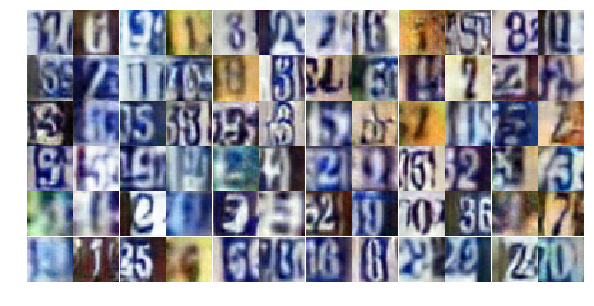

Epoch 15/20... Discriminator Loss: 1.5685... Generator Loss: 0.3263
Epoch 15/20... Discriminator Loss: 0.7828... Generator Loss: 1.0256
Epoch 15/20... Discriminator Loss: 0.5876... Generator Loss: 1.3221
Epoch 15/20... Discriminator Loss: 0.7574... Generator Loss: 1.0812
Epoch 15/20... Discriminator Loss: 0.6381... Generator Loss: 1.0559
Epoch 15/20... Discriminator Loss: 0.7888... Generator Loss: 0.8112
Epoch 15/20... Discriminator Loss: 0.7159... Generator Loss: 0.9309
Epoch 15/20... Discriminator Loss: 0.3909... Generator Loss: 1.7026
Epoch 15/20... Discriminator Loss: 1.0825... Generator Loss: 0.6145
Epoch 16/20... Discriminator Loss: 1.0871... Generator Loss: 0.5977


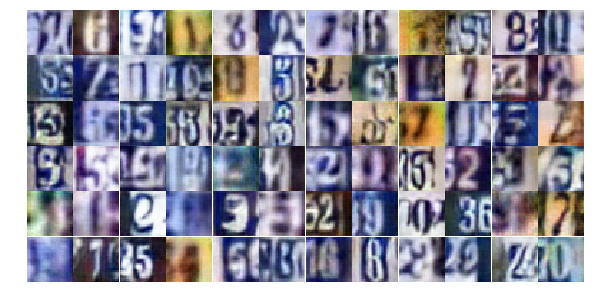

Epoch 16/20... Discriminator Loss: 0.6448... Generator Loss: 1.0181
Epoch 16/20... Discriminator Loss: 0.7285... Generator Loss: 1.1017
Epoch 16/20... Discriminator Loss: 1.0563... Generator Loss: 0.5986
Epoch 16/20... Discriminator Loss: 0.5642... Generator Loss: 1.3238
Epoch 16/20... Discriminator Loss: 0.6507... Generator Loss: 1.2113
Epoch 16/20... Discriminator Loss: 0.9088... Generator Loss: 2.5937
Epoch 16/20... Discriminator Loss: 1.3361... Generator Loss: 0.4475
Epoch 16/20... Discriminator Loss: 0.6676... Generator Loss: 0.9750
Epoch 16/20... Discriminator Loss: 0.5255... Generator Loss: 1.2163
Epoch 16/20... Discriminator Loss: 0.5750... Generator Loss: 1.5038


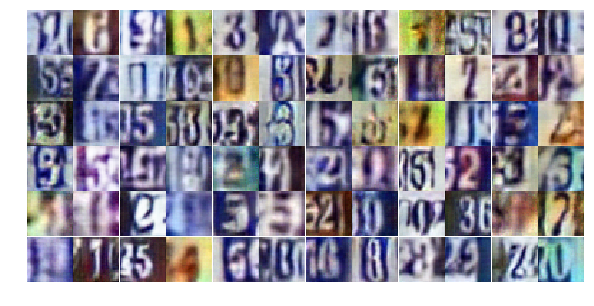

Epoch 16/20... Discriminator Loss: 1.3045... Generator Loss: 0.4482
Epoch 16/20... Discriminator Loss: 0.5079... Generator Loss: 1.4254
Epoch 16/20... Discriminator Loss: 0.5816... Generator Loss: 1.2821
Epoch 16/20... Discriminator Loss: 1.4346... Generator Loss: 0.3790
Epoch 16/20... Discriminator Loss: 0.6068... Generator Loss: 1.0528
Epoch 16/20... Discriminator Loss: 0.6504... Generator Loss: 1.0251
Epoch 16/20... Discriminator Loss: 1.6392... Generator Loss: 0.2938
Epoch 16/20... Discriminator Loss: 1.2552... Generator Loss: 0.7519
Epoch 16/20... Discriminator Loss: 0.4698... Generator Loss: 1.4570
Epoch 16/20... Discriminator Loss: 0.5569... Generator Loss: 1.6644


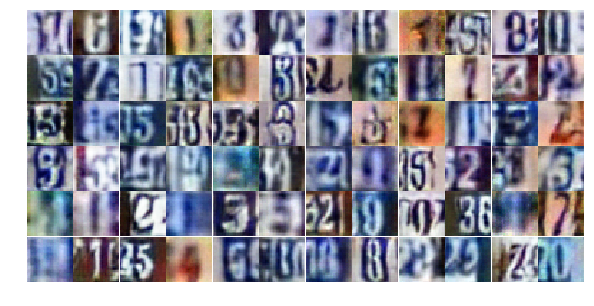

Epoch 16/20... Discriminator Loss: 0.7065... Generator Loss: 1.0519
Epoch 16/20... Discriminator Loss: 0.5372... Generator Loss: 1.2333
Epoch 16/20... Discriminator Loss: 0.7735... Generator Loss: 0.9061
Epoch 16/20... Discriminator Loss: 1.2862... Generator Loss: 0.4089
Epoch 16/20... Discriminator Loss: 0.6966... Generator Loss: 1.1799
Epoch 16/20... Discriminator Loss: 1.2193... Generator Loss: 0.4946
Epoch 16/20... Discriminator Loss: 0.6616... Generator Loss: 1.0460
Epoch 16/20... Discriminator Loss: 0.3692... Generator Loss: 1.6216
Epoch 16/20... Discriminator Loss: 1.1583... Generator Loss: 0.6866
Epoch 16/20... Discriminator Loss: 0.6252... Generator Loss: 1.1397


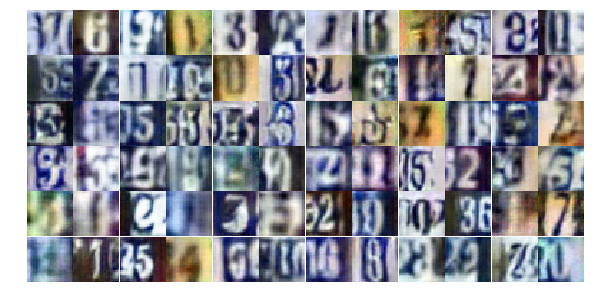

Epoch 16/20... Discriminator Loss: 0.5143... Generator Loss: 1.4557
Epoch 16/20... Discriminator Loss: 0.5670... Generator Loss: 1.2842
Epoch 16/20... Discriminator Loss: 0.6402... Generator Loss: 2.1477
Epoch 16/20... Discriminator Loss: 1.0185... Generator Loss: 0.8060
Epoch 16/20... Discriminator Loss: 1.4933... Generator Loss: 0.3601
Epoch 16/20... Discriminator Loss: 0.7300... Generator Loss: 1.2083
Epoch 16/20... Discriminator Loss: 0.8421... Generator Loss: 0.7487
Epoch 16/20... Discriminator Loss: 1.3684... Generator Loss: 0.4528
Epoch 16/20... Discriminator Loss: 1.1081... Generator Loss: 0.6308
Epoch 16/20... Discriminator Loss: 0.5438... Generator Loss: 1.2570


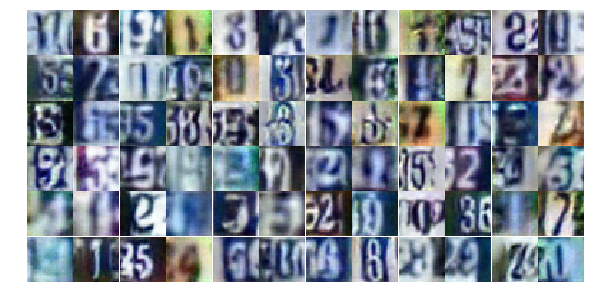

Epoch 16/20... Discriminator Loss: 0.5197... Generator Loss: 1.5348
Epoch 16/20... Discriminator Loss: 1.2143... Generator Loss: 0.5290
Epoch 16/20... Discriminator Loss: 1.2899... Generator Loss: 0.4387
Epoch 16/20... Discriminator Loss: 1.3834... Generator Loss: 0.4581
Epoch 16/20... Discriminator Loss: 1.2269... Generator Loss: 0.5966
Epoch 16/20... Discriminator Loss: 0.8236... Generator Loss: 0.9584
Epoch 16/20... Discriminator Loss: 0.4961... Generator Loss: 1.6663
Epoch 16/20... Discriminator Loss: 0.8974... Generator Loss: 0.7932
Epoch 16/20... Discriminator Loss: 0.5889... Generator Loss: 1.0567
Epoch 16/20... Discriminator Loss: 0.6999... Generator Loss: 0.9321


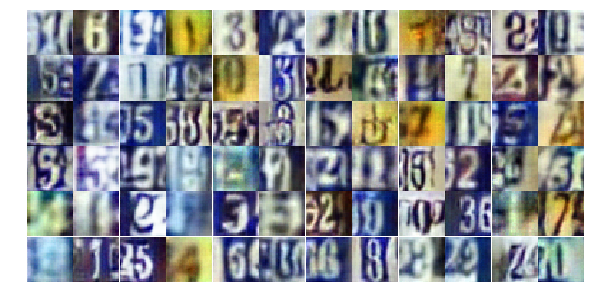

Epoch 16/20... Discriminator Loss: 1.0092... Generator Loss: 0.7095
Epoch 16/20... Discriminator Loss: 0.8202... Generator Loss: 0.8192
Epoch 16/20... Discriminator Loss: 1.8323... Generator Loss: 0.2431
Epoch 16/20... Discriminator Loss: 0.5654... Generator Loss: 2.0950
Epoch 16/20... Discriminator Loss: 0.5461... Generator Loss: 1.2366
Epoch 16/20... Discriminator Loss: 0.7818... Generator Loss: 0.8866
Epoch 17/20... Discriminator Loss: 0.7946... Generator Loss: 0.9632
Epoch 17/20... Discriminator Loss: 0.7150... Generator Loss: 1.1789
Epoch 17/20... Discriminator Loss: 0.6954... Generator Loss: 1.0098
Epoch 17/20... Discriminator Loss: 0.5346... Generator Loss: 1.4398


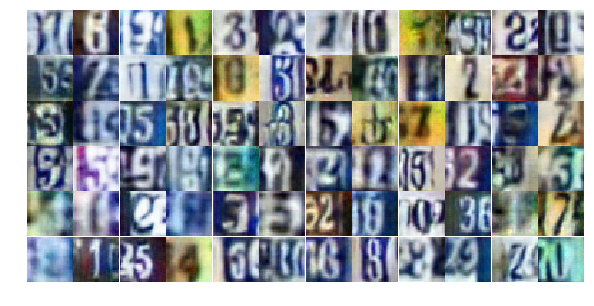

Epoch 17/20... Discriminator Loss: 0.4956... Generator Loss: 1.4637
Epoch 17/20... Discriminator Loss: 0.7037... Generator Loss: 0.9193
Epoch 17/20... Discriminator Loss: 0.7193... Generator Loss: 1.0356
Epoch 17/20... Discriminator Loss: 0.8300... Generator Loss: 0.8544
Epoch 17/20... Discriminator Loss: 0.9733... Generator Loss: 0.7177
Epoch 17/20... Discriminator Loss: 1.0769... Generator Loss: 0.6301
Epoch 17/20... Discriminator Loss: 0.7197... Generator Loss: 1.2731
Epoch 17/20... Discriminator Loss: 0.6527... Generator Loss: 1.0881
Epoch 17/20... Discriminator Loss: 0.3757... Generator Loss: 1.7091
Epoch 17/20... Discriminator Loss: 0.7782... Generator Loss: 1.0453


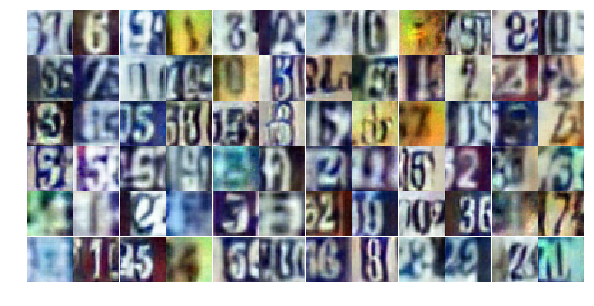

Epoch 17/20... Discriminator Loss: 0.7639... Generator Loss: 1.7425
Epoch 17/20... Discriminator Loss: 0.8753... Generator Loss: 0.8211
Epoch 17/20... Discriminator Loss: 0.6188... Generator Loss: 1.0292
Epoch 17/20... Discriminator Loss: 0.6735... Generator Loss: 1.0542
Epoch 17/20... Discriminator Loss: 0.6898... Generator Loss: 1.0077
Epoch 17/20... Discriminator Loss: 0.9800... Generator Loss: 0.6591
Epoch 17/20... Discriminator Loss: 0.7136... Generator Loss: 0.9208
Epoch 17/20... Discriminator Loss: 0.6875... Generator Loss: 1.4897
Epoch 17/20... Discriminator Loss: 1.0644... Generator Loss: 0.5682
Epoch 17/20... Discriminator Loss: 0.5905... Generator Loss: 1.0843


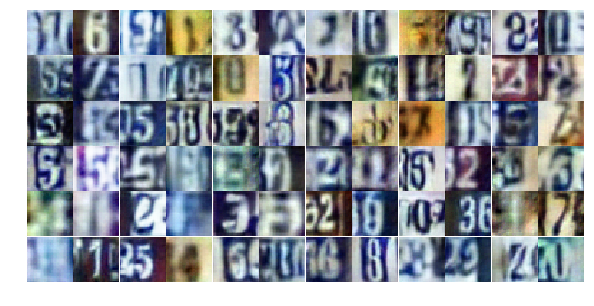

Epoch 17/20... Discriminator Loss: 1.5262... Generator Loss: 0.3712
Epoch 17/20... Discriminator Loss: 0.5238... Generator Loss: 1.3169
Epoch 17/20... Discriminator Loss: 0.4259... Generator Loss: 1.8209
Epoch 17/20... Discriminator Loss: 1.2584... Generator Loss: 0.4656
Epoch 17/20... Discriminator Loss: 1.0851... Generator Loss: 0.5926
Epoch 17/20... Discriminator Loss: 0.5563... Generator Loss: 1.1655
Epoch 17/20... Discriminator Loss: 0.9720... Generator Loss: 0.6541
Epoch 17/20... Discriminator Loss: 0.9644... Generator Loss: 0.6954
Epoch 17/20... Discriminator Loss: 0.7602... Generator Loss: 1.0951
Epoch 17/20... Discriminator Loss: 0.4040... Generator Loss: 1.6111


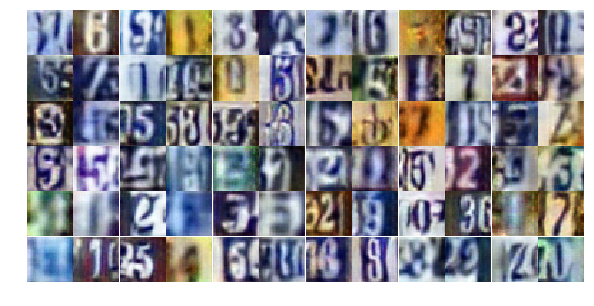

Epoch 17/20... Discriminator Loss: 0.6349... Generator Loss: 1.3450
Epoch 17/20... Discriminator Loss: 1.8601... Generator Loss: 0.2935
Epoch 17/20... Discriminator Loss: 0.8970... Generator Loss: 0.7971
Epoch 17/20... Discriminator Loss: 0.9348... Generator Loss: 0.8921
Epoch 17/20... Discriminator Loss: 0.8986... Generator Loss: 0.7400
Epoch 17/20... Discriminator Loss: 0.8776... Generator Loss: 0.7710
Epoch 17/20... Discriminator Loss: 0.5464... Generator Loss: 1.2861
Epoch 17/20... Discriminator Loss: 0.4960... Generator Loss: 1.3422
Epoch 17/20... Discriminator Loss: 0.2535... Generator Loss: 2.0892
Epoch 17/20... Discriminator Loss: 0.8877... Generator Loss: 0.8250


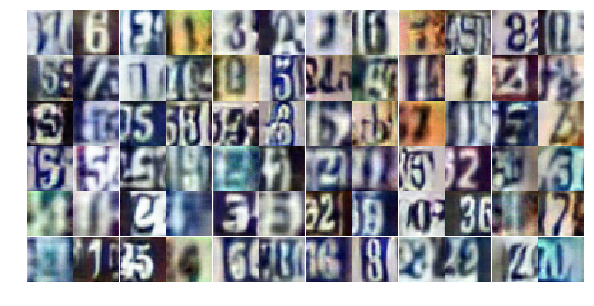

Epoch 17/20... Discriminator Loss: 0.9518... Generator Loss: 0.8028
Epoch 17/20... Discriminator Loss: 0.2552... Generator Loss: 2.1215
Epoch 17/20... Discriminator Loss: 1.0809... Generator Loss: 0.6250
Epoch 17/20... Discriminator Loss: 0.5669... Generator Loss: 1.1806
Epoch 17/20... Discriminator Loss: 0.6266... Generator Loss: 1.1953
Epoch 17/20... Discriminator Loss: 1.0806... Generator Loss: 0.5744
Epoch 17/20... Discriminator Loss: 0.8239... Generator Loss: 0.8047
Epoch 17/20... Discriminator Loss: 0.8276... Generator Loss: 0.7889
Epoch 17/20... Discriminator Loss: 1.0329... Generator Loss: 0.7291
Epoch 17/20... Discriminator Loss: 1.8305... Generator Loss: 0.2592


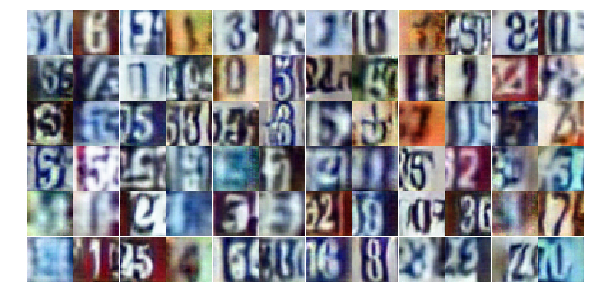

Epoch 17/20... Discriminator Loss: 0.8140... Generator Loss: 1.1652
Epoch 17/20... Discriminator Loss: 0.8756... Generator Loss: 0.8665
Epoch 17/20... Discriminator Loss: 0.5450... Generator Loss: 1.3054
Epoch 17/20... Discriminator Loss: 0.7287... Generator Loss: 0.9733
Epoch 18/20... Discriminator Loss: 1.1056... Generator Loss: 0.5326
Epoch 18/20... Discriminator Loss: 0.8462... Generator Loss: 0.7800
Epoch 18/20... Discriminator Loss: 0.7110... Generator Loss: 1.0187
Epoch 18/20... Discriminator Loss: 0.8635... Generator Loss: 0.7564
Epoch 18/20... Discriminator Loss: 1.0379... Generator Loss: 0.7347
Epoch 18/20... Discriminator Loss: 0.6415... Generator Loss: 1.0909


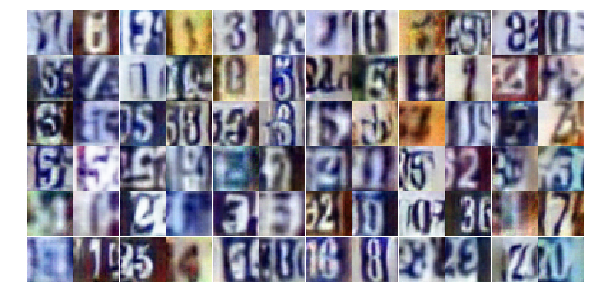

Epoch 18/20... Discriminator Loss: 0.4711... Generator Loss: 1.4254
Epoch 18/20... Discriminator Loss: 1.1045... Generator Loss: 0.6220
Epoch 18/20... Discriminator Loss: 1.2513... Generator Loss: 0.5106
Epoch 18/20... Discriminator Loss: 0.5302... Generator Loss: 1.2669
Epoch 18/20... Discriminator Loss: 0.6807... Generator Loss: 1.0252
Epoch 18/20... Discriminator Loss: 0.8912... Generator Loss: 0.7404
Epoch 18/20... Discriminator Loss: 0.4896... Generator Loss: 1.3983
Epoch 18/20... Discriminator Loss: 1.0141... Generator Loss: 0.6170
Epoch 18/20... Discriminator Loss: 0.5313... Generator Loss: 2.2380
Epoch 18/20... Discriminator Loss: 1.5752... Generator Loss: 0.8859


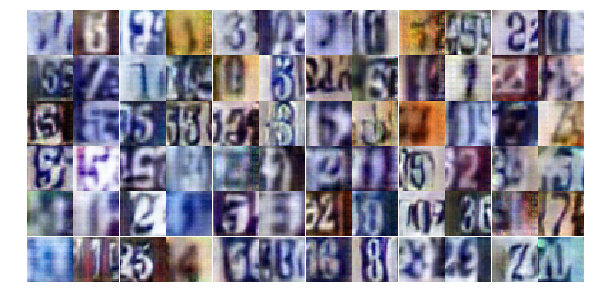

Epoch 18/20... Discriminator Loss: 0.7800... Generator Loss: 1.5606
Epoch 18/20... Discriminator Loss: 0.8471... Generator Loss: 0.9102
Epoch 18/20... Discriminator Loss: 1.0245... Generator Loss: 0.7226
Epoch 18/20... Discriminator Loss: 0.6077... Generator Loss: 1.1844
Epoch 18/20... Discriminator Loss: 0.5975... Generator Loss: 1.1410
Epoch 18/20... Discriminator Loss: 0.9206... Generator Loss: 0.8158
Epoch 18/20... Discriminator Loss: 1.1547... Generator Loss: 0.6258
Epoch 18/20... Discriminator Loss: 0.9326... Generator Loss: 0.7681
Epoch 18/20... Discriminator Loss: 0.8914... Generator Loss: 0.8080
Epoch 18/20... Discriminator Loss: 0.4889... Generator Loss: 1.3249


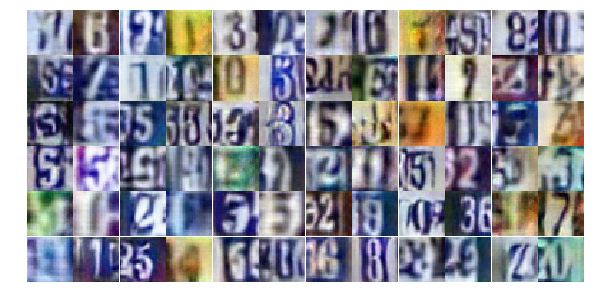

Epoch 18/20... Discriminator Loss: 0.5987... Generator Loss: 1.4632
Epoch 18/20... Discriminator Loss: 0.8541... Generator Loss: 0.8822
Epoch 18/20... Discriminator Loss: 0.6273... Generator Loss: 1.1153
Epoch 18/20... Discriminator Loss: 0.8024... Generator Loss: 0.7984
Epoch 18/20... Discriminator Loss: 1.0721... Generator Loss: 0.6175
Epoch 18/20... Discriminator Loss: 0.7214... Generator Loss: 1.0458
Epoch 18/20... Discriminator Loss: 0.6013... Generator Loss: 1.1454
Epoch 18/20... Discriminator Loss: 0.5026... Generator Loss: 1.5460
Epoch 18/20... Discriminator Loss: 0.5720... Generator Loss: 1.5765
Epoch 18/20... Discriminator Loss: 0.6894... Generator Loss: 1.4207


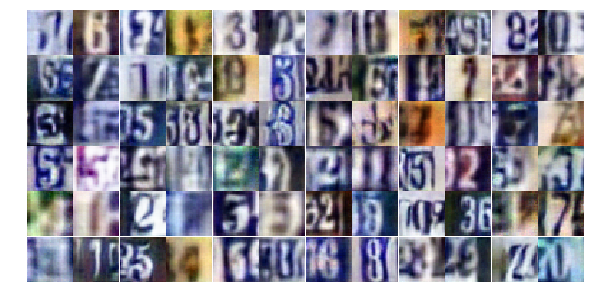

Epoch 18/20... Discriminator Loss: 0.7336... Generator Loss: 1.0849
Epoch 18/20... Discriminator Loss: 0.9334... Generator Loss: 0.7356
Epoch 18/20... Discriminator Loss: 0.7693... Generator Loss: 0.8561
Epoch 18/20... Discriminator Loss: 0.8231... Generator Loss: 0.7532
Epoch 18/20... Discriminator Loss: 0.8303... Generator Loss: 0.9464
Epoch 18/20... Discriminator Loss: 0.4566... Generator Loss: 1.3973
Epoch 18/20... Discriminator Loss: 0.8366... Generator Loss: 0.7592
Epoch 18/20... Discriminator Loss: 1.9529... Generator Loss: 3.2036
Epoch 18/20... Discriminator Loss: 1.0966... Generator Loss: 0.5949
Epoch 18/20... Discriminator Loss: 0.4677... Generator Loss: 1.4520


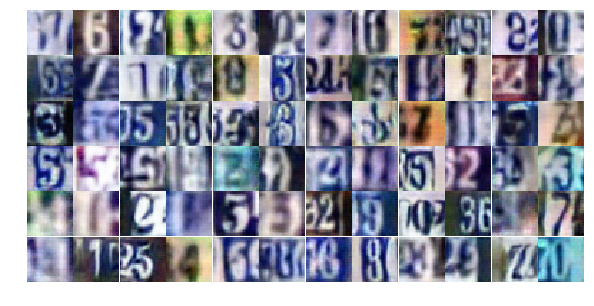

Epoch 18/20... Discriminator Loss: 0.7904... Generator Loss: 0.8309
Epoch 18/20... Discriminator Loss: 0.7490... Generator Loss: 1.0281
Epoch 18/20... Discriminator Loss: 0.7779... Generator Loss: 0.8784
Epoch 18/20... Discriminator Loss: 1.0383... Generator Loss: 0.7027
Epoch 18/20... Discriminator Loss: 0.7982... Generator Loss: 0.9002
Epoch 18/20... Discriminator Loss: 0.5446... Generator Loss: 1.3284
Epoch 18/20... Discriminator Loss: 0.4400... Generator Loss: 1.4428
Epoch 18/20... Discriminator Loss: 0.4393... Generator Loss: 1.7427
Epoch 18/20... Discriminator Loss: 0.7964... Generator Loss: 1.5651
Epoch 18/20... Discriminator Loss: 0.8203... Generator Loss: 0.7799


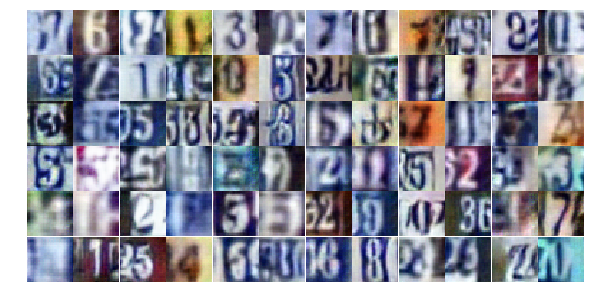

Epoch 18/20... Discriminator Loss: 0.7521... Generator Loss: 1.0628
Epoch 19/20... Discriminator Loss: 0.9092... Generator Loss: 0.7190
Epoch 19/20... Discriminator Loss: 1.2078... Generator Loss: 0.4888
Epoch 19/20... Discriminator Loss: 1.2301... Generator Loss: 0.4785
Epoch 19/20... Discriminator Loss: 0.8321... Generator Loss: 0.8143
Epoch 19/20... Discriminator Loss: 0.9756... Generator Loss: 0.8560
Epoch 19/20... Discriminator Loss: 0.5459... Generator Loss: 1.3295
Epoch 19/20... Discriminator Loss: 1.0756... Generator Loss: 0.5914
Epoch 19/20... Discriminator Loss: 0.5308... Generator Loss: 1.7320
Epoch 19/20... Discriminator Loss: 1.0105... Generator Loss: 0.7065


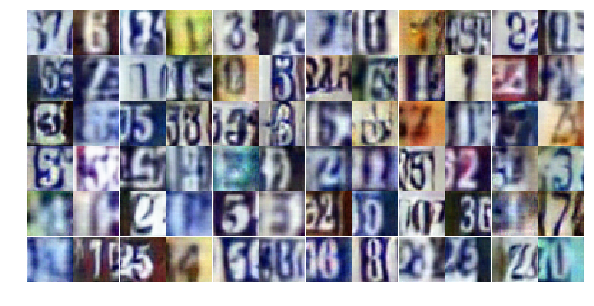

Epoch 19/20... Discriminator Loss: 0.8842... Generator Loss: 0.6766
Epoch 19/20... Discriminator Loss: 0.6679... Generator Loss: 1.0058
Epoch 19/20... Discriminator Loss: 0.6786... Generator Loss: 1.0879
Epoch 19/20... Discriminator Loss: 1.0325... Generator Loss: 0.6196
Epoch 19/20... Discriminator Loss: 1.0492... Generator Loss: 0.6208
Epoch 19/20... Discriminator Loss: 0.7710... Generator Loss: 0.9434
Epoch 19/20... Discriminator Loss: 1.6615... Generator Loss: 0.3085
Epoch 19/20... Discriminator Loss: 0.6680... Generator Loss: 1.1087
Epoch 19/20... Discriminator Loss: 0.6395... Generator Loss: 2.0971
Epoch 19/20... Discriminator Loss: 0.9160... Generator Loss: 0.7552


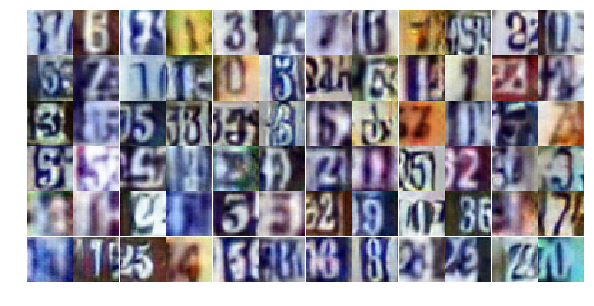

Epoch 19/20... Discriminator Loss: 0.7624... Generator Loss: 0.8678
Epoch 19/20... Discriminator Loss: 1.2121... Generator Loss: 0.5424
Epoch 19/20... Discriminator Loss: 1.4700... Generator Loss: 0.4300
Epoch 19/20... Discriminator Loss: 1.2001... Generator Loss: 0.5714
Epoch 19/20... Discriminator Loss: 1.4753... Generator Loss: 0.3464
Epoch 19/20... Discriminator Loss: 0.7967... Generator Loss: 1.3270
Epoch 19/20... Discriminator Loss: 0.7683... Generator Loss: 2.0351
Epoch 19/20... Discriminator Loss: 0.4805... Generator Loss: 1.5272
Epoch 19/20... Discriminator Loss: 0.7385... Generator Loss: 0.9053
Epoch 19/20... Discriminator Loss: 0.7789... Generator Loss: 0.9303


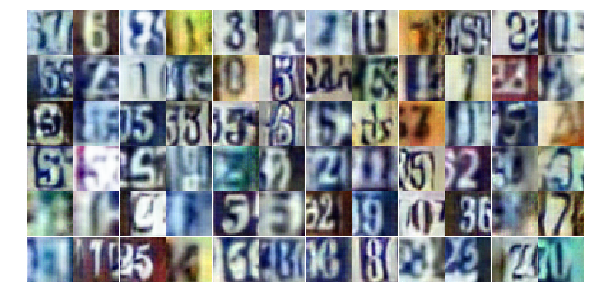

Epoch 19/20... Discriminator Loss: 1.1810... Generator Loss: 2.4113
Epoch 19/20... Discriminator Loss: 1.8273... Generator Loss: 0.5446
Epoch 19/20... Discriminator Loss: 1.5265... Generator Loss: 0.4141
Epoch 19/20... Discriminator Loss: 0.7191... Generator Loss: 1.3488
Epoch 19/20... Discriminator Loss: 0.8143... Generator Loss: 1.9714
Epoch 19/20... Discriminator Loss: 1.0397... Generator Loss: 0.6526
Epoch 19/20... Discriminator Loss: 0.7719... Generator Loss: 1.4534
Epoch 19/20... Discriminator Loss: 0.5267... Generator Loss: 1.4009
Epoch 19/20... Discriminator Loss: 0.7937... Generator Loss: 0.9907
Epoch 19/20... Discriminator Loss: 0.6864... Generator Loss: 1.0885


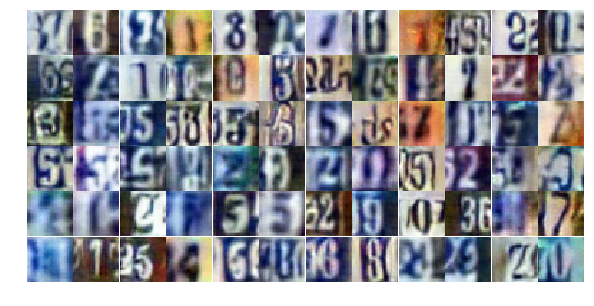

Epoch 19/20... Discriminator Loss: 0.7795... Generator Loss: 0.8127
Epoch 19/20... Discriminator Loss: 0.7469... Generator Loss: 0.9433
Epoch 19/20... Discriminator Loss: 1.0651... Generator Loss: 0.6282
Epoch 19/20... Discriminator Loss: 0.9378... Generator Loss: 0.8106
Epoch 19/20... Discriminator Loss: 0.7863... Generator Loss: 0.9115
Epoch 19/20... Discriminator Loss: 0.4837... Generator Loss: 1.5937
Epoch 19/20... Discriminator Loss: 0.4835... Generator Loss: 1.3566
Epoch 19/20... Discriminator Loss: 0.6206... Generator Loss: 1.0615
Epoch 19/20... Discriminator Loss: 0.8142... Generator Loss: 0.8965
Epoch 19/20... Discriminator Loss: 0.9692... Generator Loss: 0.7250


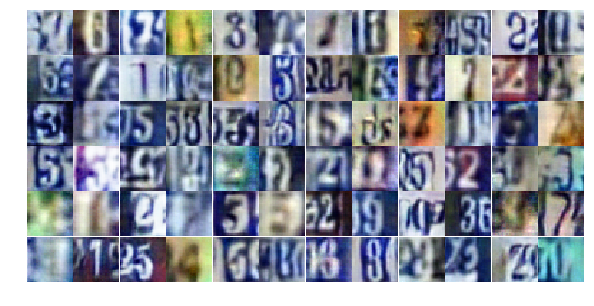

Epoch 19/20... Discriminator Loss: 1.0378... Generator Loss: 0.6184
Epoch 19/20... Discriminator Loss: 0.7863... Generator Loss: 0.8872
Epoch 19/20... Discriminator Loss: 0.6512... Generator Loss: 1.6284
Epoch 19/20... Discriminator Loss: 0.8455... Generator Loss: 0.8004
Epoch 19/20... Discriminator Loss: 0.7257... Generator Loss: 1.2729
Epoch 19/20... Discriminator Loss: 0.6509... Generator Loss: 1.4894
Epoch 19/20... Discriminator Loss: 1.5634... Generator Loss: 0.3286
Epoch 19/20... Discriminator Loss: 0.7356... Generator Loss: 0.9668
Epoch 20/20... Discriminator Loss: 0.8494... Generator Loss: 0.8501
Epoch 20/20... Discriminator Loss: 0.7587... Generator Loss: 0.9546


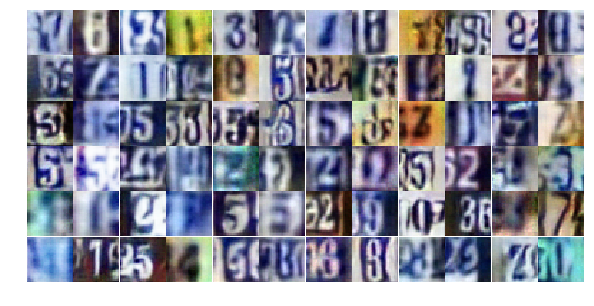

Epoch 20/20... Discriminator Loss: 0.8321... Generator Loss: 0.7728
Epoch 20/20... Discriminator Loss: 0.8615... Generator Loss: 0.8835
Epoch 20/20... Discriminator Loss: 1.4471... Generator Loss: 0.4952
Epoch 20/20... Discriminator Loss: 0.8110... Generator Loss: 0.8221
Epoch 20/20... Discriminator Loss: 0.5576... Generator Loss: 1.2785
Epoch 20/20... Discriminator Loss: 0.9395... Generator Loss: 0.7967
Epoch 20/20... Discriminator Loss: 0.8286... Generator Loss: 0.9079
Epoch 20/20... Discriminator Loss: 0.9241... Generator Loss: 0.7139
Epoch 20/20... Discriminator Loss: 0.9292... Generator Loss: 0.7198
Epoch 20/20... Discriminator Loss: 0.7048... Generator Loss: 0.9377


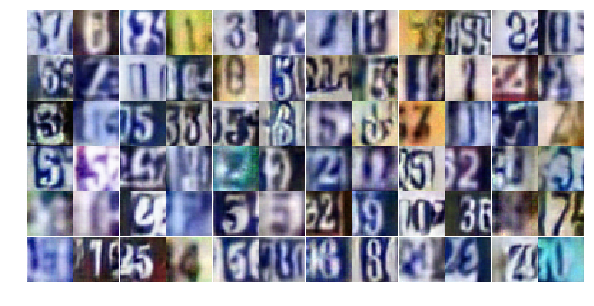

Epoch 20/20... Discriminator Loss: 1.4030... Generator Loss: 0.4143
Epoch 20/20... Discriminator Loss: 0.8834... Generator Loss: 0.7538
Epoch 20/20... Discriminator Loss: 0.8147... Generator Loss: 0.8562
Epoch 20/20... Discriminator Loss: 0.5172... Generator Loss: 1.6032
Epoch 20/20... Discriminator Loss: 1.1285... Generator Loss: 0.5854
Epoch 20/20... Discriminator Loss: 0.9744... Generator Loss: 0.6809
Epoch 20/20... Discriminator Loss: 1.3479... Generator Loss: 0.4277
Epoch 20/20... Discriminator Loss: 0.5267... Generator Loss: 1.4609
Epoch 20/20... Discriminator Loss: 0.5158... Generator Loss: 1.3806
Epoch 20/20... Discriminator Loss: 1.1616... Generator Loss: 0.5422


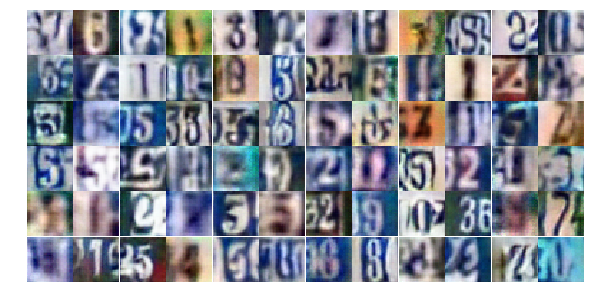

Epoch 20/20... Discriminator Loss: 0.6988... Generator Loss: 1.0961
Epoch 20/20... Discriminator Loss: 0.8660... Generator Loss: 0.7850
Epoch 20/20... Discriminator Loss: 0.4249... Generator Loss: 2.3401
Epoch 20/20... Discriminator Loss: 1.6667... Generator Loss: 0.3415
Epoch 20/20... Discriminator Loss: 0.7869... Generator Loss: 0.8801
Epoch 20/20... Discriminator Loss: 0.4879... Generator Loss: 1.3576
Epoch 20/20... Discriminator Loss: 0.5410... Generator Loss: 1.2294
Epoch 20/20... Discriminator Loss: 1.8378... Generator Loss: 0.2317
Epoch 20/20... Discriminator Loss: 0.8315... Generator Loss: 0.8927
Epoch 20/20... Discriminator Loss: 0.5953... Generator Loss: 3.1698


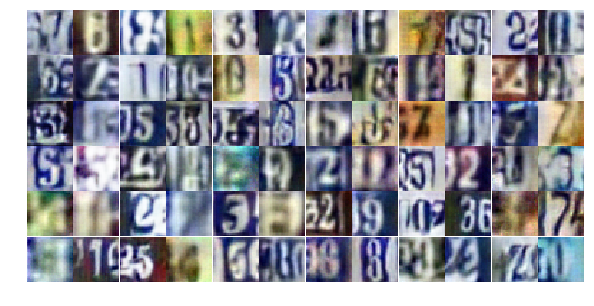

Epoch 20/20... Discriminator Loss: 0.5325... Generator Loss: 1.6085
Epoch 20/20... Discriminator Loss: 0.6491... Generator Loss: 1.0169
Epoch 20/20... Discriminator Loss: 1.3159... Generator Loss: 0.5140
Epoch 20/20... Discriminator Loss: 0.5993... Generator Loss: 1.2191
Epoch 20/20... Discriminator Loss: 0.8966... Generator Loss: 0.7726
Epoch 20/20... Discriminator Loss: 0.6810... Generator Loss: 1.9242
Epoch 20/20... Discriminator Loss: 0.8311... Generator Loss: 1.0414
Epoch 20/20... Discriminator Loss: 1.2096... Generator Loss: 0.4957
Epoch 20/20... Discriminator Loss: 0.7491... Generator Loss: 1.2089
Epoch 20/20... Discriminator Loss: 1.4476... Generator Loss: 0.3966


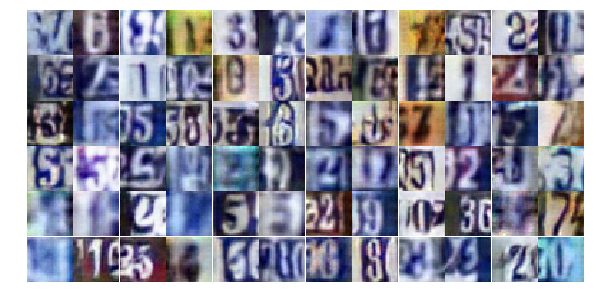

Epoch 20/20... Discriminator Loss: 1.0860... Generator Loss: 0.6839
Epoch 20/20... Discriminator Loss: 0.7074... Generator Loss: 1.1815
Epoch 20/20... Discriminator Loss: 1.3661... Generator Loss: 0.5617
Epoch 20/20... Discriminator Loss: 0.6841... Generator Loss: 1.1304
Epoch 20/20... Discriminator Loss: 0.8312... Generator Loss: 0.8948
Epoch 20/20... Discriminator Loss: 1.0241... Generator Loss: 0.6246
Epoch 20/20... Discriminator Loss: 1.2196... Generator Loss: 0.4759
Epoch 20/20... Discriminator Loss: 0.5127... Generator Loss: 1.6177
Epoch 20/20... Discriminator Loss: 0.8437... Generator Loss: 0.8221
Epoch 20/20... Discriminator Loss: 0.7273... Generator Loss: 1.0234


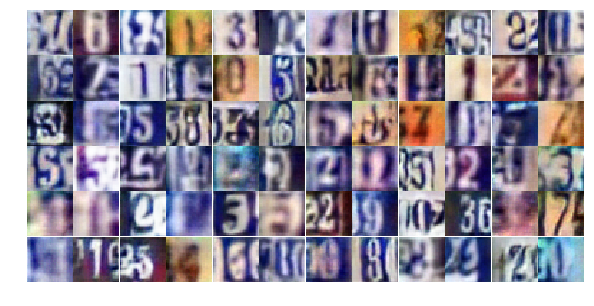

Epoch 20/20... Discriminator Loss: 0.5703... Generator Loss: 1.3874
Epoch 20/20... Discriminator Loss: 0.7807... Generator Loss: 0.9592
Epoch 20/20... Discriminator Loss: 0.5348... Generator Loss: 1.1926
Epoch 20/20... Discriminator Loss: 1.4969... Generator Loss: 2.5934
Epoch 20/20... Discriminator Loss: 0.6665... Generator Loss: 1.0285
Epoch 20/20... Discriminator Loss: 0.3656... Generator Loss: 1.7433


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

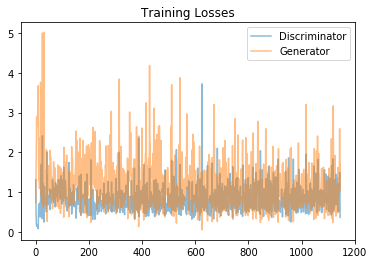

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

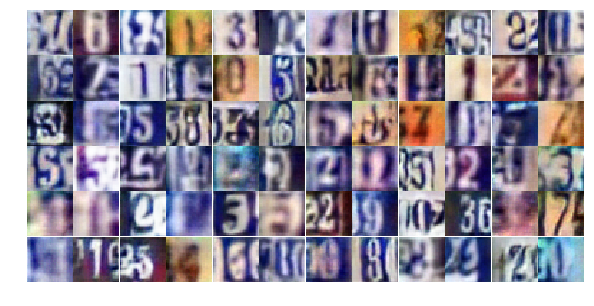

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))